In [8]:
!pip install kaggle

In [9]:
!mkdir .kaggle

mkdir: cannot create directory ‘.kaggle’: File exists


In [10]:
import json
token={"username":"akkinasrikar","key":"6db5bd59a8f6b70702cc774fb7ccae58"}
with open('./kaggle.json', 'w') as file:
    json.dump(token, file)

In [11]:
!cp ./kaggle.json ~/.kaggle/kaggle.json

In [12]:
!kaggle config set -n path -v{./}

- path is now set to: {./}


In [13]:
!chmod 600 /root/.kaggle/kaggle.json

In [14]:
!kaggle datasets download -d ipythonx/retinal-vessel-segmentation

 97%|██████████████████████████████████████▋ | 434M/448M [00:09<00:00, 31.9MB/s]
100%|████████████████████████████████████████| 448M/448M [00:10<00:00, 47.0MB/s]


In [15]:
from IPython.display import clear_output 

In [16]:
!unzip "./{./}/datasets/ipythonx/retinal-vessel-segmentation/retinal-vessel-segmentation.zip"
clear_output()

In [17]:
import os

In [18]:
!pip install tensorflow.io

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 4.3 MB/s eta 0:00:0000:0100:010m
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.8/14.8 MB 22.5 MB/s eta 0:00:0000:0100:01
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 132.0/132.0 KB 7.5 MB/s eta 0:00:00
  Created wheel for wrapt: filename=wrapt-1.12.1-cp37-cp37m-linux_x86_64.whl size=77048 sha256=6fd93dfb7c4d1eb46c9a80b365198d0d93fbd6dc9598fde8604cfaf24191a761
  Stored in directory: /root/.cache/pip/wheels/62/76/4c/aa25851149f3f6d9785f6c869387ad82b3fd37582fa8147ac6
Successfully built wrapt
  Attempting uninstall: wrapt
    Found existing installation: wrapt 1.14.0
    Uninstalling wrapt-1.14.0:
      Successfully uninstalled wrapt-1.14.0
  Attempting uninstall: typing-extensions
    Found existing installation: typing_extensions 4.2.0
    Uninstalling typing_extensions-4.2.0:
      Successfully uninstalled typing_extensions-4.2.0
  Attempting uninstall: six
    Found existing installatio

In [19]:
!pip install -U -q segmentation-models --user


from PIL import Image
import numpy as np 
import cv2
import pandas as pd 
from tensorflow.keras.layers import Conv2D, BatchNormalization, Activation, MaxPool2D, Conv2DTranspose, Concatenate, Input
from tensorflow.keras.models import Model
import segmentation_models as sm
import matplotlib.pyplot as plt 
import tensorflow_io as tfio
import tensorflow as tf
from skimage import io


exts = ('jpg', 'JPG', 'png', 'PNG', 'tif', 'gif', 'ppm')

  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask-cudf 21.10.1 requires cupy-cuda114, which is not installed.
beatrix-jupyterlab 3.1.7 requires google-cloud-bigquery-storage, which is not installed.
tfx-bsl 1.7.0 requires pyarrow<6,>=1, but you have pyarrow 7.0.0 which is incompatible.
tfx-bsl 1.7.0 requires tensorflow!=2.0.*,!=2.1.*,!=2.2.*,!=2.3.*,!=2.4.*,!=2.5.*,!=2.6.*,!=2.7.*,<3,>=1.15.5, but you have tensorflow 2.6.3 which is incompatible.
tensorflow 2.6.3 requires numpy~=1.19.2, but you have numpy 1.21.6 which is incompatible.
tensorflow-transform 1.7.0 requires pyarrow<6,>=1, but you have pyarrow 7.0.0 which is incompatible.
tensorflow-transform 1.7.0 requires tensorflow!=2.0.*,!=2.1.*,!=2.2.*,!=2.3.*,!=2.4.*,!=2.5.*,!=2.6.*,!=2.7.*,<2.

In [20]:
!pip install Augmentor

In [22]:
#os.listdir("./DRIVE/training/output")

In [23]:
os.listdir("./DRIVE/training/")

['images', 'mask', '1st_manual']

In [24]:
os.listdir("./DRIVE/training")

['images', 'mask', '1st_manual']

In [26]:
train_img_li = os.listdir("./DRIVE/training/images")
train_mask_li = os.listdir("./DRIVE/training/mask")
train_op_li=os.listdir("./DRIVE/training/1st_manual")

In [27]:
def restrict_normalized(imgs,mask=False):
    imgs_normalized = np.empty(imgs.shape)
    imgs_std = np.std(imgs)
    imgs_mean = np.mean(imgs)
    imgs_normalized = (imgs-imgs_mean)/imgs_std
    for i in range(imgs.shape[2]):
        imgs_normalized[:,:,i] = ((imgs_normalized[:,:,i] - np.min(imgs_normalized[:,:,i])) / (np.max(imgs_normalized[:,:,i])-np.min(imgs_normalized[:,:,i])))*255
    return imgs_normalized

def clahe_equalized(imgs):
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    imgs_equalized = np.empty(imgs.shape)
    for i in range(imgs.shape[2]):
        imgs_equalized[:,:,i] = clahe.apply(np.array(imgs[:,:,i], dtype = np.uint8))
    return imgs_equalized

def adjust_gamma(imgs, gamma=1.0): 
    invGamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** invGamma) * 255 for i in np.arange(0, 256)]).astype("uint8")
    new_imgs = np.empty(imgs.shape)
    for i in range(imgs.shape[2]):
        new_imgs[:,:,i] = cv2.LUT(np.array(imgs[:,:,i], dtype = np.uint8), table)
    return new_imgs

def preprocess(image,mask):

    assert np.max(mask)==1
    image=np.array(image)
    image[:,:,0]=image[:,:,0]*mask
    image[:,:,1]=image[:,:,1]*mask
    image[:,:,2]=image[:,:,2]*mask

    image=restrict_normalized(image,mask)
    image=clahe_equalized(image)
    image=adjust_gamma(image,1.2)

    image=image/255.0
    return image

In [28]:
os.mkdir("HIGHRES")

In [29]:
train_img_li[0]

'39_training.tif'

(584, 565, 3)
(584, 565, 3)


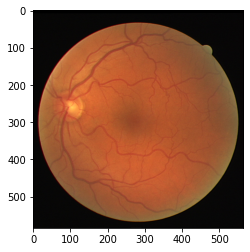

(584, 565, 3)
(584, 565, 3)


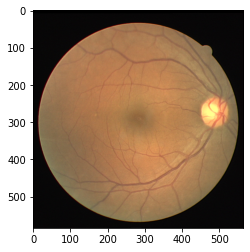

(584, 565, 3)
(584, 565, 3)


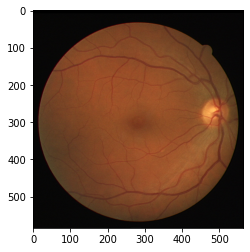

(584, 565, 3)
(584, 565, 3)


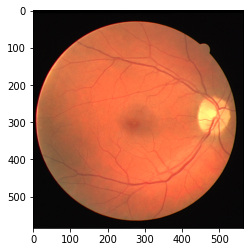

(584, 565, 3)
(584, 565, 3)


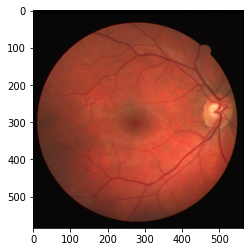

(584, 565, 3)
(584, 565, 3)


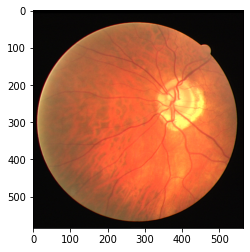

(584, 565, 3)
(584, 565, 3)


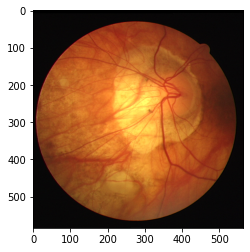

(584, 565, 3)
(584, 565, 3)


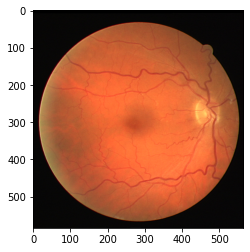

(584, 565, 3)
(584, 565, 3)


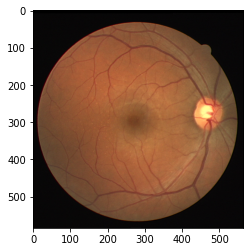

(584, 565, 3)
(584, 565, 3)


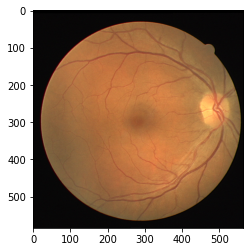

(584, 565, 3)
(584, 565, 3)


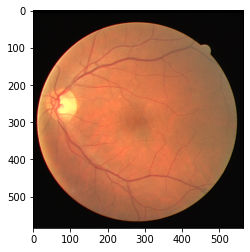

(584, 565, 3)
(584, 565, 3)


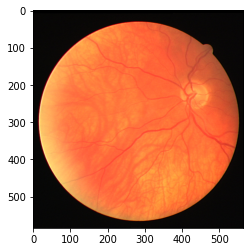

(584, 565, 3)
(584, 565, 3)


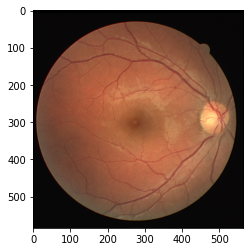

(584, 565, 3)
(584, 565, 3)


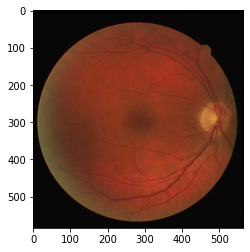

(584, 565, 3)
(584, 565, 3)


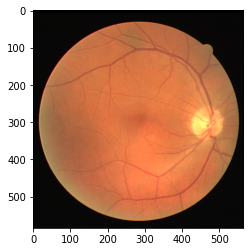

(584, 565, 3)
(584, 565, 3)


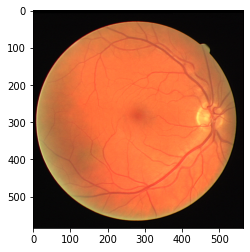

(584, 565, 3)
(584, 565, 3)


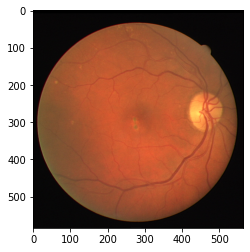

(584, 565, 3)
(584, 565, 3)


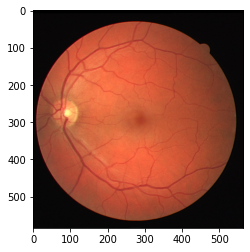

(584, 565, 3)
(584, 565, 3)


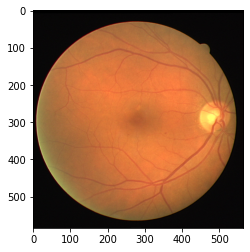

(584, 565, 3)
(584, 565, 3)


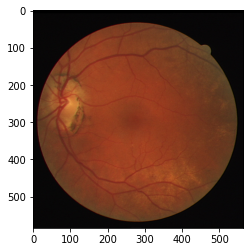

In [31]:
train_li = []
if len(train_img_li) == len(train_mask_li):
    for i in range(len(train_img_li)):
        img = io.imread("./DRIVE/training/images/" +train_img_li[i])
        print(img.shape)
        mask = io.imread("./DRIVE/training/mask/" +train_mask_li[i])
        op = io.imread("./DRIVE/training/1st_manual/" +train_op_li[i])
        pic = preprocess(img,mask/255)
        #im = Image.fromarray((pic * 255).astype(np.uint8))
        #im.save("./HIGHRES/"+train_img_li[i])
        plt.imshow(img)
        print(pic.shape)
        plt.show()

In [32]:
#os.listdir("./HIGHRES/")

In [34]:
input_data = "./DRIVE/training/images"
images = sorted(
    [
        os.path.join(input_data, fname)
        for fname in os.listdir(input_data)
    ]
)

In [35]:
target_data = "./DRIVE/training/1st_manual"
masks = sorted(
    [
        os.path.join(target_data, fname)
        for fname in os.listdir(target_data)
    ]
)

In [ ]:
images

In [36]:
print("Number of samples:", len(images), len(masks))
for input_path, target_path in zip(images[:10], masks[:10]):
    print(input_path[-31:], "|", target_path[-34:])

Number of samples: 20 20
training/images/21_training.tif | training/1st_manual/21_manual1.gif
training/images/22_training.tif | training/1st_manual/22_manual1.gif
training/images/23_training.tif | training/1st_manual/23_manual1.gif
training/images/24_training.tif | training/1st_manual/24_manual1.gif
training/images/25_training.tif | training/1st_manual/25_manual1.gif
training/images/26_training.tif | training/1st_manual/26_manual1.gif
training/images/27_training.tif | training/1st_manual/27_manual1.gif
training/images/28_training.tif | training/1st_manual/28_manual1.gif
training/images/29_training.tif | training/1st_manual/29_manual1.gif
training/images/30_training.tif | training/1st_manual/30_manual1.gif


In [113]:
IMAGE_SIZE = 512
BATCH_SIZE = 8

def read_files(image_path, mask=False):
    image = tf.io.read_file(image_path)
    #image = io.imread(image_path)
    if mask:
        image = tf.io.decode_gif(image) 
        image = tf.squeeze(image)
        #image=clahe_equalized(image)
        #image=adjust_gamma(image,1.2)
        image = tf.image.rgb_to_grayscale(image) 
        image = tf.divide(image, 128)
        image.set_shape([None, None, 1])
        image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
        image = tf.cast(image, tf.int32)
        
        
    else:
        try:
            image = tfio.experimental.image.decode_tiff(image)
        except: 
            image = tf.io.decode_image(image)
        image = image[:,:,:3] # out: (h, w, 3)
        image.set_shape([None, None, 3])
        #image=clahe_equalized(image)
        #image=adjust_gamma(image,1.2)
        image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
        image = image / 255.
    return image

In [114]:
from tensorflow.keras import layers

In [115]:
def load_data(image_list, mask_list):
    image = read_files(image_list)
    mask  = read_files(mask_list, mask=True)
    return image, mask


def data_generator(image_list, mask_list):
    dataset = tf.data.Dataset.from_tensor_slices((image_list, mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=False)
    dataset = dataset.prefetch(4)
    return dataset

In [116]:
train_dataset = data_generator(images,masks)
train_dataset

<PrefetchDataset shapes: ((None, 512, 512, 3), (None, 512, 512, 1)), types: (tf.float32, tf.int32)>

In [117]:
def visualize(**images):
    n = len(images) 
    plt.figure(figsize=(20, 20))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image, cmap='gray')
    plt.show()

(8, 512, 512, 3) (8, 512, 512, 1)
0 1
[0 1]


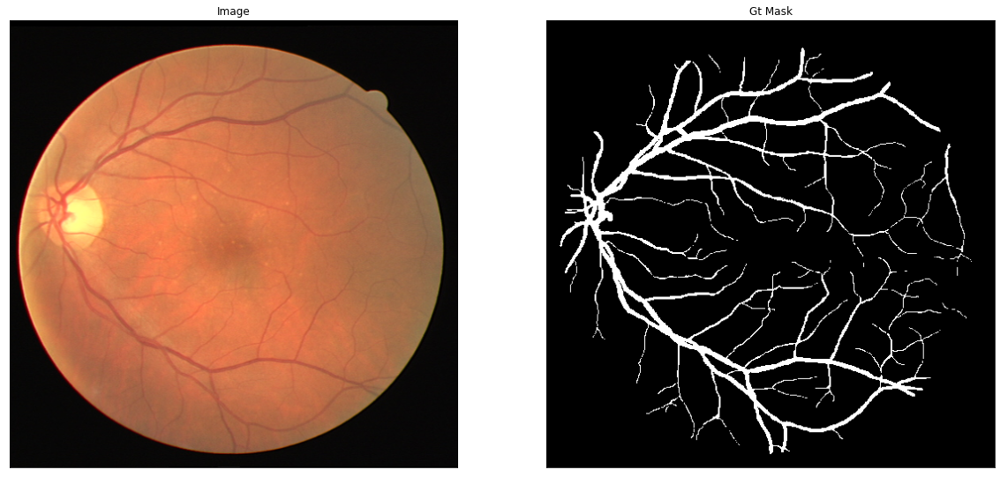

0 1
[0 1]


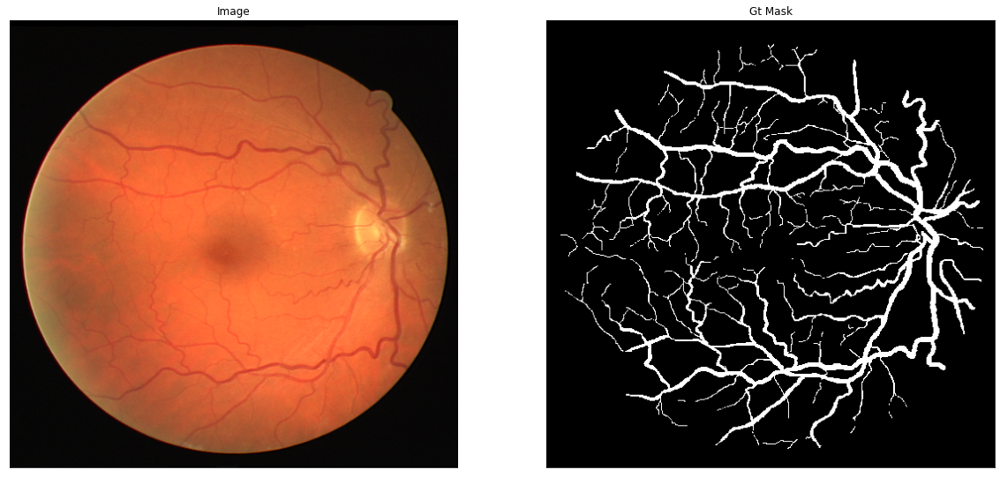

0 1
[0 1]


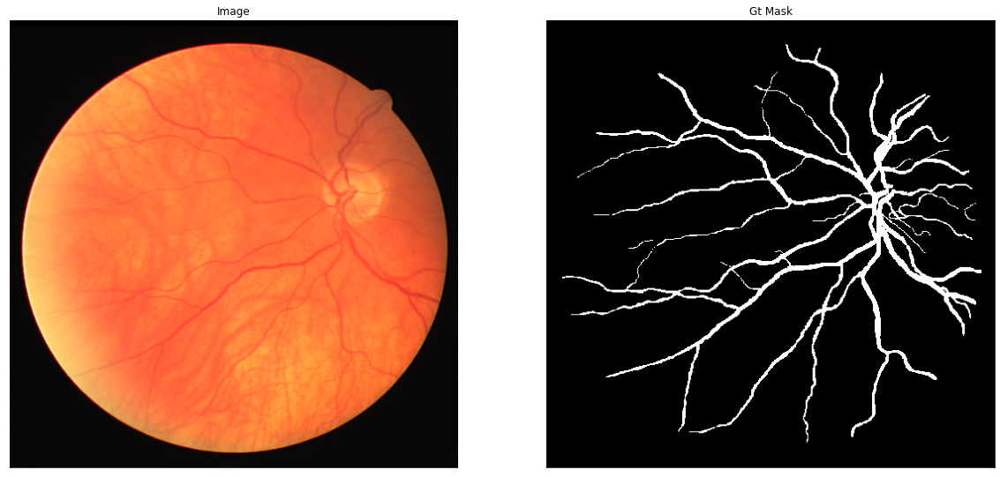

0 1
[0 1]


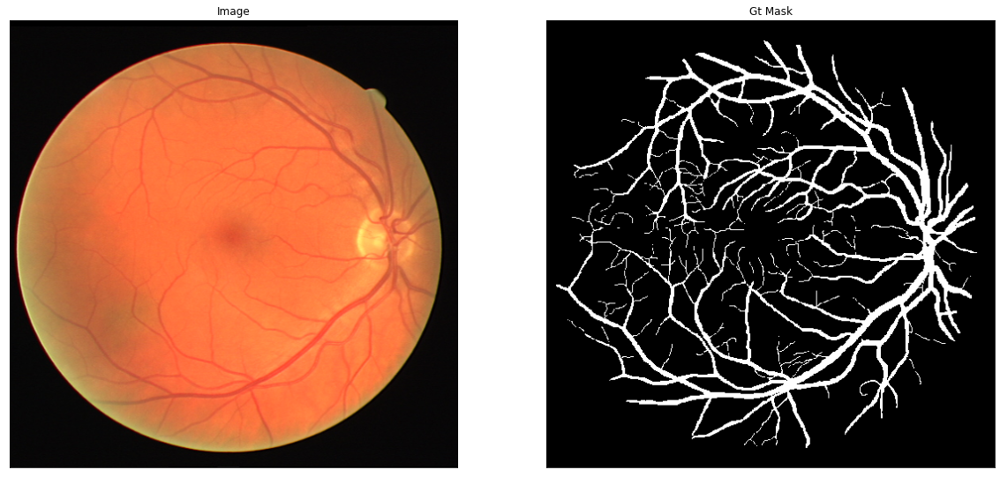

0 1
[0 1]


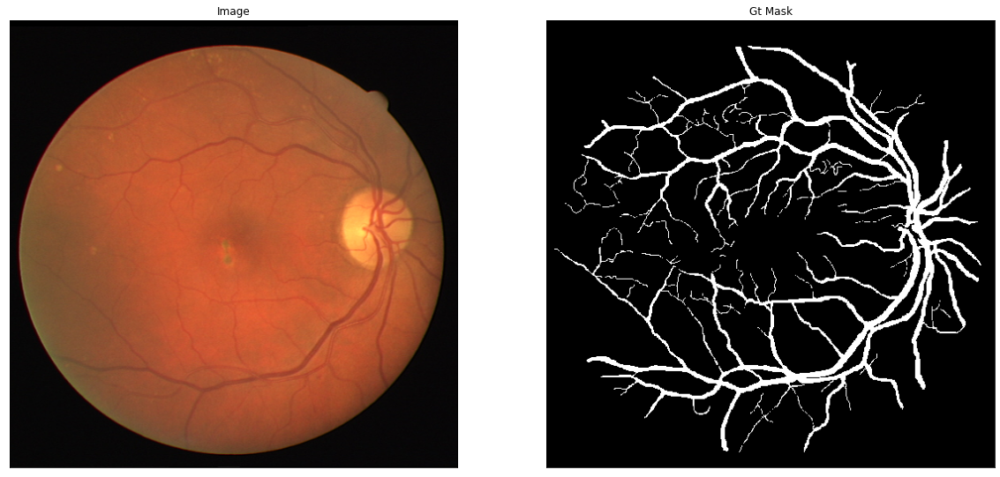

0 1
[0 1]


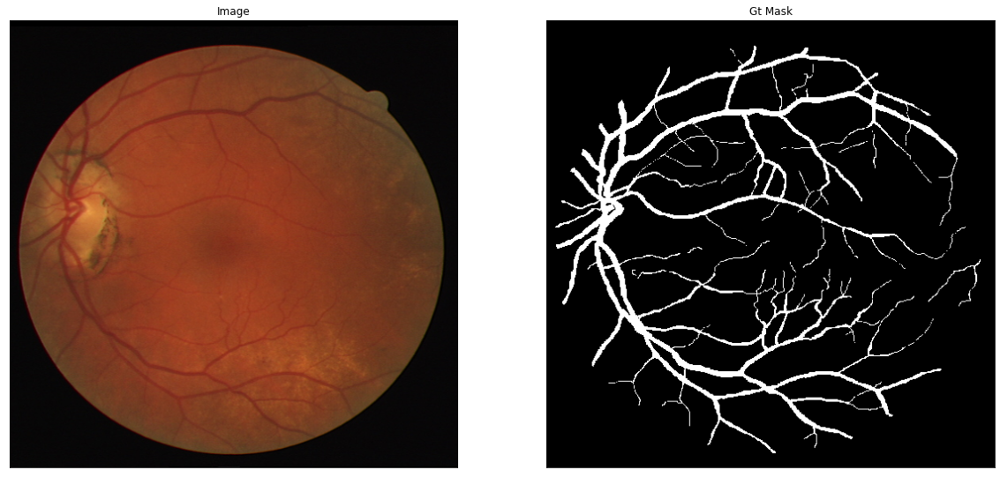

0 1
[0 1]


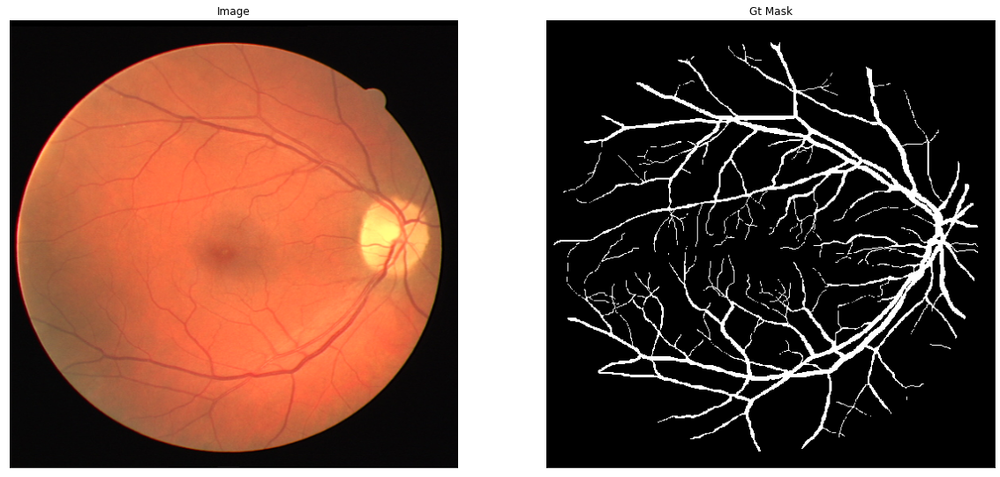

0 1
[0 1]


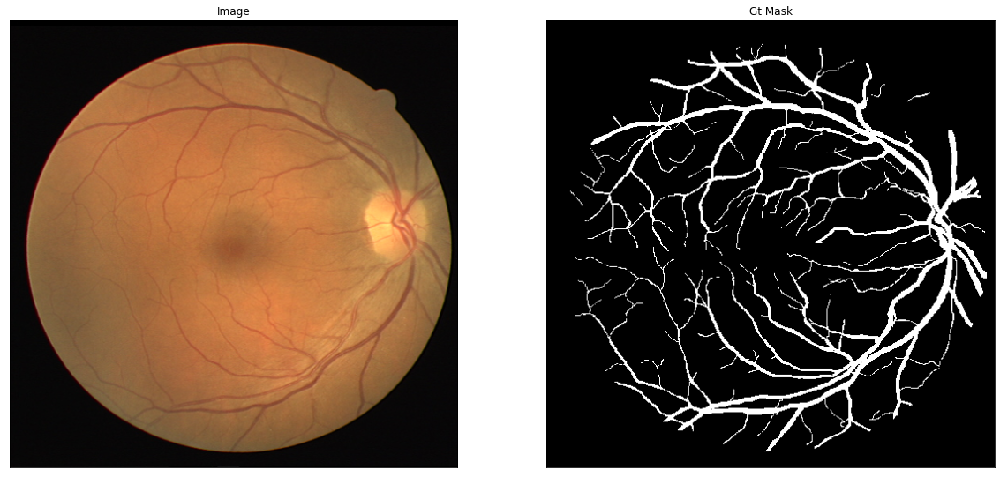

In [118]:
image, mask = next(iter(train_dataset.take(1))) 
print(image.shape, mask.shape)

for (img, msk) in zip(image[:10], mask[:10]):
    print(mask.numpy().min(), mask.numpy().max())
    print(np.unique(mask.numpy()))
    visualize(
        image=img.numpy(),
        gt_mask=msk.numpy(),
    )

In [164]:
import segmentation_models as sm

sm.set_framework('tf.keras')

sm.framework()

'tf.keras'

In [165]:
from tensorflow import keras 
keras.backend.clear_session()
BACKBONE   = 'efficientnetb0'
n_classes  = 1 
activation = 'sigmoid' 
model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
model.summary(line_length=110)

16818176/16804768 [==============================] - 1s 0us/step
Model: "model"
______________________________________________________________________________________________________________
Layer (type)                        Output Shape            Param #      Connected to                         
input_1 (InputLayer)                [(None, None, None, 3)] 0                                                 
______________________________________________________________________________________________________________
stem_conv (Conv2D)                  (None, None, None, 32)  864          input_1[0][0]                        
______________________________________________________________________________________________________________
stem_bn (BatchNormalization)        (None, None, None, 32)  128          stem_conv[0][0]                      
______________________________________________________________________________________________________________
stem_activation (Activation)    

In [120]:
class DisplayCallback(keras.callbacks.Callback):
    def __init__(self, dataset, epoch_interval=5):
        self.dataset = dataset
        self.epoch_interval = epoch_interval
    
    def display(self, display_list, extra_title=''):
        plt.figure(figsize=(15, 15))
        title = ['Input Image', 'True Mask', 'Predicted Mask']

        if len(display_list) > len(title):
            title.append(extra_title)

        for i in range(len(display_list)):
            plt.subplot(1, len(display_list), i+1)
            plt.title(title[i])
            plt.imshow(display_list[i], cmap='gray')
            plt.axis('off')
        plt.show()
        
    def create_mask(self, pred_mask):
        pred_mask = (pred_mask > 0.5).astype("int32")
        return pred_mask[0]
    
    def show_predictions(self, dataset, num=1):
        for image, mask in dataset.take(num):
            pred_mask = model.predict(image)
            self.display([image[0], mask[0], self.create_mask(pred_mask)])
        
    def on_epoch_end(self, epoch, logs=None):
        if epoch and epoch % self.epoch_interval == 0:
            self.show_predictions(self.dataset)
            print ('\nSample Prediction after epoch {}\n'.format(epoch+1))

In [121]:
def iou(y_true, y_pred):
    def f(y_true, y_pred):
        intersection = (y_true * y_pred).sum()
        union = y_true.sum() + y_pred.sum() - intersection
        x = (intersection + 1e-15) / (union + 1e-15)
        x = x.astype(np.float32)
        return x
    return tf.numpy_function(f, [y_true, y_pred], tf.float32)

In [122]:
smooth = 1e-15
def dice_coef(y_true, y_pred):
    y_true = tf.keras.layers.Flatten()(y_true)
    y_pred = tf.keras.layers.Flatten()(y_pred)
    intersection = tf.reduce_sum(y_true * y_pred)
    return (2. * intersection + smooth) / (tf.reduce_sum(y_true) + tf.reduce_sum(y_pred) + smooth)

In [123]:
def dice_loss(y_true, y_pred):
    return 1.0 - dice_coef(y_true, y_pred)

In [124]:
def conv_block(Input,num_filters):
    x=Conv2D(num_filters,3,padding="same")(Input)
    x=BatchNormalization()(x)
    x=Activation("relu")(x)
    x=Conv2D(num_filters, 3, padding="same")(x)
    x=BatchNormalization()(x)
    x=Activation("relu")(x)
    return x

In [125]:
def encoder_block(Input,num_filters):
    x=conv_block(Input,num_filters)
    p=MaxPool2D((2, 2))(x)
    return x,p

In [126]:
def decoder_block(Input, skip_features, num_filters):
    x=Conv2DTranspose(num_filters, (2, 2), strides=2, padding="same")(Input)
    x=Concatenate()([x,skip_features])
    x=conv_block(x,num_filters)
    return x

In [127]:
def build_unet(input_shape):
    inputs = Input(input_shape)
    
    s1, p1 = encoder_block(inputs, 64)
    s2, p2 = encoder_block(p1, 128)
    s3, p3 = encoder_block(p2, 256)
    s4, p4 = encoder_block(p3, 512)
    
    b1 = conv_block(p4, 1024)
    
    d1 = decoder_block(b1, s4, 512)
    d2 = decoder_block(d1, s3, 256)
    d3 = decoder_block(d2, s2, 128)
    d4 = decoder_block(d3, s1, 64)

    outputs = Conv2D(1, 1, padding="same", activation="sigmoid")(d4)

    model = Model(inputs, outputs, name="U-Net")
    return model

In [128]:
input_shape = (512, 512, 3)
model = build_unet(input_shape)

In [129]:
model.summary()

Model: "U-Net"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 512, 512, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 512, 512, 64) 1792        input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 512, 512, 64) 256         conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 512, 512, 64) 0           batch_normalization[0][0]        
______________________________________________________________________________________________

In [130]:
from tensorflow.keras.metrics import Recall, Precision
from tensorflow.keras.optimizers import Adam

In [167]:
optim = keras.optimizers.Adam(0.0001)
bce   = keras.losses.BinaryCrossentropy()
metrics = ["accuracy",dice_coef, iou, Recall(), Precision()]

lr = 1e-4

# compile keras model with defined optimozer, loss and metrics
model.compile(optim, bce, metrics)
#model.compile(loss=dice_loss, optimizer=Adam(lr), metrics=[dice_coef, iou, Recall(), Precision()])

Epoch 1/400
3/3 [==============================] - 18s 1s/step - loss: 0.8185 - accuracy: 0.4688 - dice_coef: 0.1516 - iou: 0.0820 - recall: 0.5543 - precision: 0.0882
Epoch 2/400
3/3 [==============================] - 1s 330ms/step - loss: 0.7665 - accuracy: 0.5725 - dice_coef: 0.1658 - iou: 0.0904 - recall: 0.6258 - precision: 0.1199
Epoch 3/400
3/3 [==============================] - 1s 364ms/step - loss: 0.7264 - accuracy: 0.6275 - dice_coef: 0.1771 - iou: 0.0972 - recall: 0.6774 - precision: 0.1446
Epoch 4/400
3/3 [==============================] - 1s 332ms/step - loss: 0.6940 - accuracy: 0.6621 - dice_coef: 0.1865 - iou: 0.1028 - recall: 0.7138 - precision: 0.1639
Epoch 5/400
3/3 [==============================] - 1s 331ms/step - loss: 0.6662 - accuracy: 0.6887 - dice_coef: 0.1945 - iou: 0.1077 - recall: 0.7386 - precision: 0.1804
Epoch 6/400
3/3 [==============================] - 1s 329ms/step - loss: 0.6409 - accuracy: 0.7125 - dice_coef: 0.2017 - iou: 0.1122 - recall: 0.7564 - 

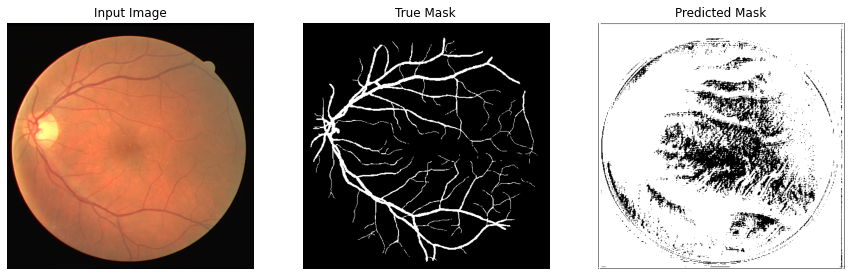


Sample Prediction after epoch 6

Epoch 7/400
3/3 [==============================] - 1s 330ms/step - loss: 0.6166 - accuracy: 0.7392 - dice_coef: 0.2078 - iou: 0.1159 - recall: 0.7632 - precision: 0.2145
Epoch 8/400
3/3 [==============================] - 1s 358ms/step - loss: 0.5921 - accuracy: 0.7680 - dice_coef: 0.2129 - iou: 0.1192 - recall: 0.7629 - precision: 0.2367
Epoch 9/400
3/3 [==============================] - 1s 331ms/step - loss: 0.5663 - accuracy: 0.7973 - dice_coef: 0.2169 - iou: 0.1216 - recall: 0.7538 - precision: 0.2633
Epoch 10/400
3/3 [==============================] - 1s 331ms/step - loss: 0.5409 - accuracy: 0.8242 - dice_coef: 0.2201 - iou: 0.1237 - recall: 0.7414 - precision: 0.2935
Epoch 11/400
3/3 [==============================] - 1s 326ms/step - loss: 0.5182 - accuracy: 0.8458 - dice_coef: 0.2241 - iou: 0.1262 - recall: 0.7340 - precision: 0.3248


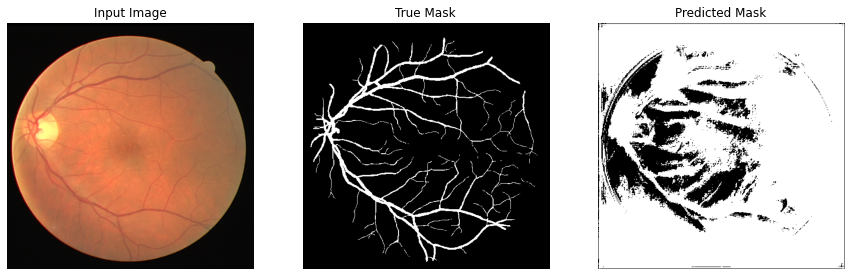


Sample Prediction after epoch 11

Epoch 12/400
3/3 [==============================] - 1s 331ms/step - loss: 0.4959 - accuracy: 0.8641 - dice_coef: 0.2287 - iou: 0.1291 - recall: 0.7255 - precision: 0.3572
Epoch 13/400
3/3 [==============================] - 1s 383ms/step - loss: 0.4756 - accuracy: 0.8799 - dice_coef: 0.2313 - iou: 0.1308 - recall: 0.7164 - precision: 0.3917
Epoch 14/400
3/3 [==============================] - 1s 350ms/step - loss: 0.4571 - accuracy: 0.8925 - dice_coef: 0.2347 - iou: 0.1330 - recall: 0.7078 - precision: 0.4250
Epoch 15/400
3/3 [==============================] - 1s 332ms/step - loss: 0.4412 - accuracy: 0.9001 - dice_coef: 0.2426 - iou: 0.1380 - recall: 0.7166 - precision: 0.4494
Epoch 16/400
3/3 [==============================] - 1s 337ms/step - loss: 0.4266 - accuracy: 0.9064 - dice_coef: 0.2493 - iou: 0.1424 - recall: 0.7227 - precision: 0.4712


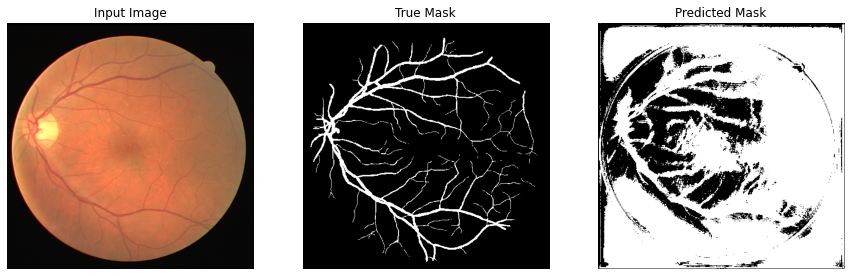


Sample Prediction after epoch 16

Epoch 17/400
3/3 [==============================] - 1s 331ms/step - loss: 0.4140 - accuracy: 0.9138 - dice_coef: 0.2530 - iou: 0.1448 - recall: 0.7198 - precision: 0.4992
Epoch 18/400
3/3 [==============================] - 1s 354ms/step - loss: 0.4019 - accuracy: 0.9183 - dice_coef: 0.2597 - iou: 0.1493 - recall: 0.7251 - precision: 0.5179
Epoch 19/400
3/3 [==============================] - 1s 336ms/step - loss: 0.3921 - accuracy: 0.9223 - dice_coef: 0.2643 - iou: 0.1523 - recall: 0.7264 - precision: 0.5358
Epoch 20/400
3/3 [==============================] - 1s 331ms/step - loss: 0.3822 - accuracy: 0.9267 - dice_coef: 0.2695 - iou: 0.1558 - recall: 0.7293 - precision: 0.5567
Epoch 21/400
3/3 [==============================] - 1s 331ms/step - loss: 0.3731 - accuracy: 0.9290 - dice_coef: 0.2770 - iou: 0.1608 - recall: 0.7401 - precision: 0.5672


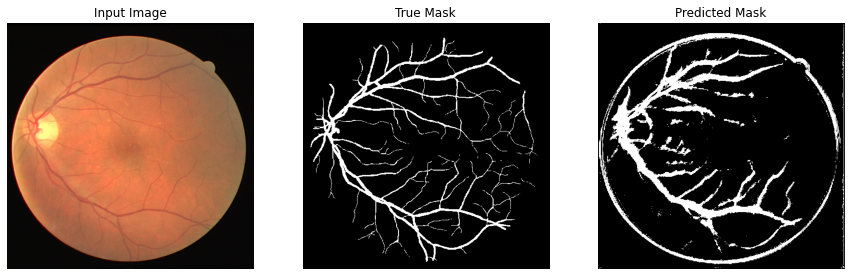


Sample Prediction after epoch 21

Epoch 22/400
3/3 [==============================] - 1s 331ms/step - loss: 0.3651 - accuracy: 0.9347 - dice_coef: 0.2746 - iou: 0.1592 - recall: 0.7248 - precision: 0.5997
Epoch 23/400
3/3 [==============================] - 1s 320ms/step - loss: 0.3569 - accuracy: 0.9356 - dice_coef: 0.2862 - iou: 0.1670 - recall: 0.7421 - precision: 0.6020
Epoch 24/400
3/3 [==============================] - 1s 360ms/step - loss: 0.3492 - accuracy: 0.9390 - dice_coef: 0.2891 - iou: 0.1690 - recall: 0.7447 - precision: 0.6216
Epoch 25/400
3/3 [==============================] - 1s 335ms/step - loss: 0.3422 - accuracy: 0.9422 - dice_coef: 0.2915 - iou: 0.1707 - recall: 0.7405 - precision: 0.6421
Epoch 26/400
3/3 [==============================] - 1s 329ms/step - loss: 0.3357 - accuracy: 0.9426 - dice_coef: 0.3013 - iou: 0.1774 - recall: 0.7549 - precision: 0.6412


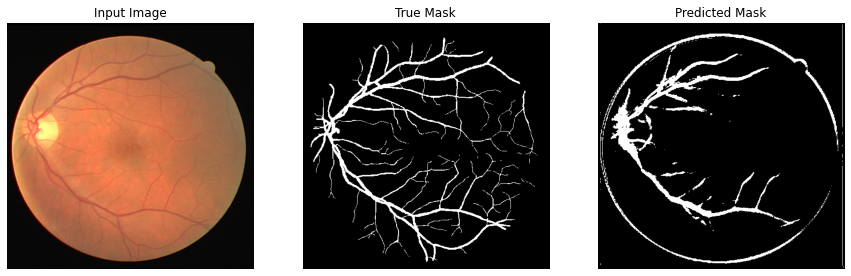


Sample Prediction after epoch 26

Epoch 27/400
3/3 [==============================] - 1s 330ms/step - loss: 0.3294 - accuracy: 0.9465 - dice_coef: 0.2996 - iou: 0.1762 - recall: 0.7426 - precision: 0.6709
Epoch 28/400
3/3 [==============================] - 1s 331ms/step - loss: 0.3232 - accuracy: 0.9466 - dice_coef: 0.3092 - iou: 0.1829 - recall: 0.7540 - precision: 0.6680
Epoch 29/400
3/3 [==============================] - 2s 354ms/step - loss: 0.3174 - accuracy: 0.9490 - dice_coef: 0.3090 - iou: 0.1828 - recall: 0.7498 - precision: 0.6867
Epoch 30/400
3/3 [==============================] - 1s 326ms/step - loss: 0.3113 - accuracy: 0.9504 - dice_coef: 0.3148 - iou: 0.1868 - recall: 0.7525 - precision: 0.6956
Epoch 31/400
3/3 [==============================] - 1s 325ms/step - loss: 0.3058 - accuracy: 0.9502 - dice_coef: 0.3245 - iou: 0.1937 - recall: 0.7688 - precision: 0.6890


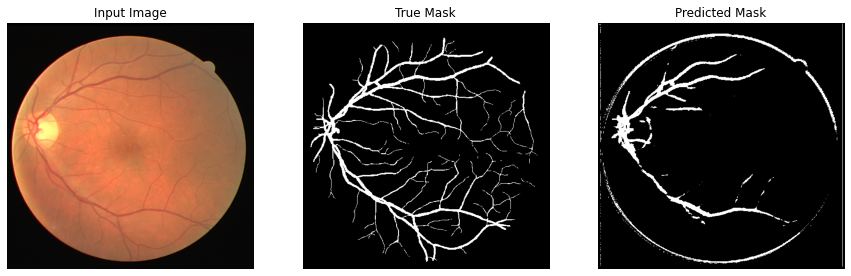


Sample Prediction after epoch 31

Epoch 32/400
3/3 [==============================] - 1s 328ms/step - loss: 0.3001 - accuracy: 0.9531 - dice_coef: 0.3225 - iou: 0.1922 - recall: 0.7564 - precision: 0.7151
Epoch 33/400
3/3 [==============================] - 1s 328ms/step - loss: 0.2951 - accuracy: 0.9529 - dice_coef: 0.3318 - iou: 0.1989 - recall: 0.7667 - precision: 0.7093
Epoch 34/400
3/3 [==============================] - 1s 335ms/step - loss: 0.2897 - accuracy: 0.9541 - dice_coef: 0.3352 - iou: 0.2014 - recall: 0.7653 - precision: 0.7188
Epoch 35/400
3/3 [==============================] - 1s 343ms/step - loss: 0.2849 - accuracy: 0.9549 - dice_coef: 0.3390 - iou: 0.2041 - recall: 0.7640 - precision: 0.7261
Epoch 36/400
3/3 [==============================] - 1s 332ms/step - loss: 0.2801 - accuracy: 0.9553 - dice_coef: 0.3444 - iou: 0.2081 - recall: 0.7657 - precision: 0.7285


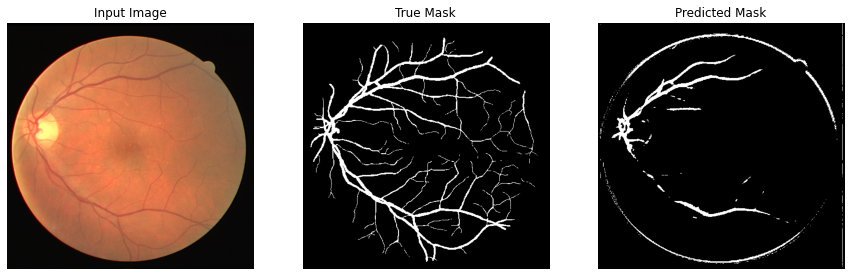


Sample Prediction after epoch 36

Epoch 37/400
3/3 [==============================] - 1s 328ms/step - loss: 0.2756 - accuracy: 0.9566 - dice_coef: 0.3453 - iou: 0.2087 - recall: 0.7634 - precision: 0.7405
Epoch 38/400
3/3 [==============================] - 1s 331ms/step - loss: 0.2708 - accuracy: 0.9570 - dice_coef: 0.3528 - iou: 0.2142 - recall: 0.7706 - precision: 0.7403
Epoch 39/400
3/3 [==============================] - 1s 327ms/step - loss: 0.2666 - accuracy: 0.9574 - dice_coef: 0.3572 - iou: 0.2175 - recall: 0.7693 - precision: 0.7445
Epoch 40/400
3/3 [==============================] - 1s 332ms/step - loss: 0.2625 - accuracy: 0.9581 - dice_coef: 0.3613 - iou: 0.2205 - recall: 0.7720 - precision: 0.7484
Epoch 41/400
3/3 [==============================] - 1s 358ms/step - loss: 0.2587 - accuracy: 0.9588 - dice_coef: 0.3642 - iou: 0.2227 - recall: 0.7701 - precision: 0.7560


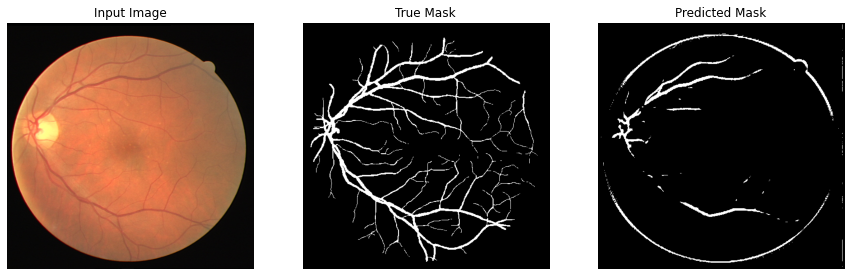


Sample Prediction after epoch 41

Epoch 42/400
3/3 [==============================] - 1s 325ms/step - loss: 0.2549 - accuracy: 0.9591 - dice_coef: 0.3696 - iou: 0.2267 - recall: 0.7724 - precision: 0.7568
Epoch 43/400
3/3 [==============================] - 1s 330ms/step - loss: 0.2518 - accuracy: 0.9598 - dice_coef: 0.3718 - iou: 0.2284 - recall: 0.7713 - precision: 0.7634
Epoch 44/400
3/3 [==============================] - 1s 329ms/step - loss: 0.2479 - accuracy: 0.9606 - dice_coef: 0.3756 - iou: 0.2312 - recall: 0.7728 - precision: 0.7704
Epoch 45/400
3/3 [==============================] - 1s 340ms/step - loss: 0.2448 - accuracy: 0.9606 - dice_coef: 0.3815 - iou: 0.2358 - recall: 0.7791 - precision: 0.7664
Epoch 46/400
3/3 [==============================] - 1s 333ms/step - loss: 0.2421 - accuracy: 0.9614 - dice_coef: 0.3801 - iou: 0.2347 - recall: 0.7695 - precision: 0.7788


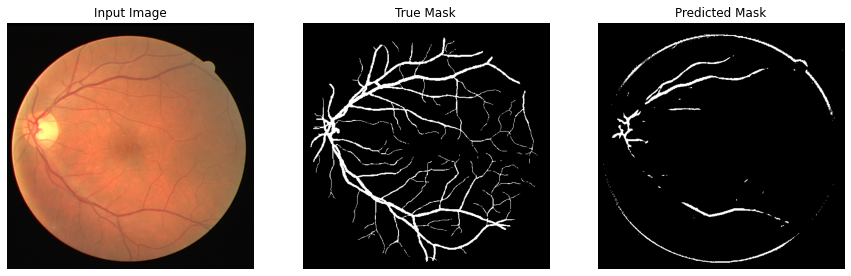


Sample Prediction after epoch 46

Epoch 47/400
3/3 [==============================] - 1s 331ms/step - loss: 0.2393 - accuracy: 0.9612 - dice_coef: 0.3866 - iou: 0.2396 - recall: 0.7771 - precision: 0.7734
Epoch 48/400
3/3 [==============================] - 1s 331ms/step - loss: 0.2364 - accuracy: 0.9620 - dice_coef: 0.3877 - iou: 0.2405 - recall: 0.7736 - precision: 0.7824
Epoch 49/400
3/3 [==============================] - 1s 333ms/step - loss: 0.2340 - accuracy: 0.9618 - dice_coef: 0.3944 - iou: 0.2457 - recall: 0.7810 - precision: 0.7767
Epoch 50/400
3/3 [==============================] - 1s 324ms/step - loss: 0.2326 - accuracy: 0.9633 - dice_coef: 0.3839 - iou: 0.2376 - recall: 0.7574 - precision: 0.8044
Epoch 51/400
3/3 [==============================] - 1s 342ms/step - loss: 0.2293 - accuracy: 0.9630 - dice_coef: 0.3949 - iou: 0.2461 - recall: 0.7723 - precision: 0.7922


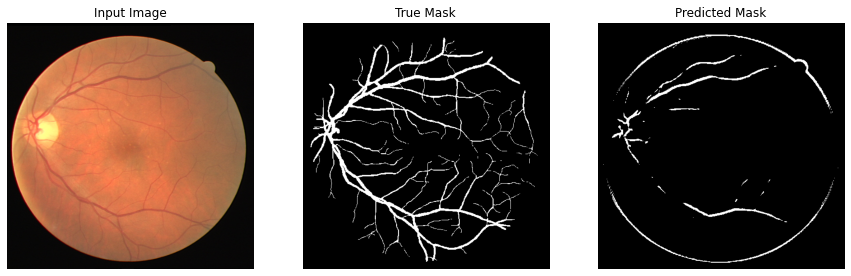


Sample Prediction after epoch 51

Epoch 52/400
3/3 [==============================] - 1s 338ms/step - loss: 0.2285 - accuracy: 0.9618 - dice_coef: 0.4031 - iou: 0.2525 - recall: 0.7899 - precision: 0.7717
Epoch 53/400
3/3 [==============================] - 1s 330ms/step - loss: 0.2250 - accuracy: 0.9635 - dice_coef: 0.3972 - iou: 0.2478 - recall: 0.7694 - precision: 0.7988
Epoch 54/400
3/3 [==============================] - 1s 330ms/step - loss: 0.2223 - accuracy: 0.9635 - dice_coef: 0.4050 - iou: 0.2539 - recall: 0.7775 - precision: 0.7936
Epoch 55/400
3/3 [==============================] - 1s 330ms/step - loss: 0.2207 - accuracy: 0.9632 - dice_coef: 0.4110 - iou: 0.2586 - recall: 0.7871 - precision: 0.7855
Epoch 56/400
3/3 [==============================] - 1s 327ms/step - loss: 0.2180 - accuracy: 0.9644 - dice_coef: 0.4060 - iou: 0.2547 - recall: 0.7705 - precision: 0.8072


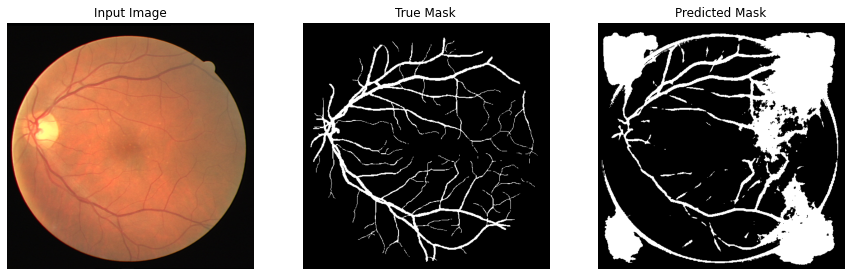


Sample Prediction after epoch 56

Epoch 57/400
3/3 [==============================] - 1s 324ms/step - loss: 0.2158 - accuracy: 0.9644 - dice_coef: 0.4114 - iou: 0.2590 - recall: 0.7757 - precision: 0.8034
Epoch 58/400
3/3 [==============================] - 1s 327ms/step - loss: 0.2136 - accuracy: 0.9641 - dice_coef: 0.4188 - iou: 0.2649 - recall: 0.7870 - precision: 0.7941
Epoch 59/400
3/3 [==============================] - 1s 336ms/step - loss: 0.2118 - accuracy: 0.9646 - dice_coef: 0.4178 - iou: 0.2641 - recall: 0.7804 - precision: 0.8026
Epoch 60/400
3/3 [==============================] - 1s 339ms/step - loss: 0.2095 - accuracy: 0.9652 - dice_coef: 0.4186 - iou: 0.2647 - recall: 0.7758 - precision: 0.8113
Epoch 61/400
3/3 [==============================] - 1s 330ms/step - loss: 0.2071 - accuracy: 0.9651 - dice_coef: 0.4250 - iou: 0.2699 - recall: 0.7857 - precision: 0.8045


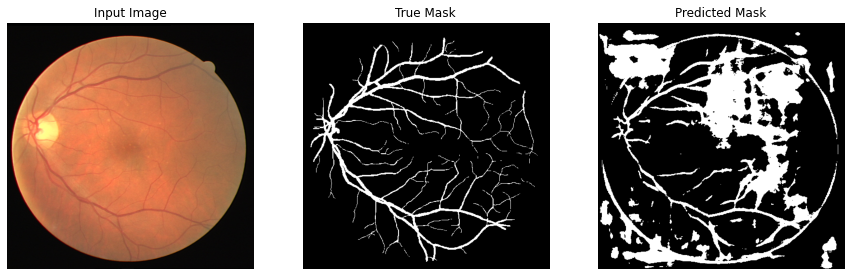


Sample Prediction after epoch 61

Epoch 62/400
3/3 [==============================] - 1s 330ms/step - loss: 0.2049 - accuracy: 0.9657 - dice_coef: 0.4266 - iou: 0.2711 - recall: 0.7854 - precision: 0.8104
Epoch 63/400
3/3 [==============================] - 1s 329ms/step - loss: 0.2027 - accuracy: 0.9661 - dice_coef: 0.4282 - iou: 0.2724 - recall: 0.7814 - precision: 0.8169
Epoch 64/400
3/3 [==============================] - 1s 332ms/step - loss: 0.2006 - accuracy: 0.9661 - dice_coef: 0.4344 - iou: 0.2775 - recall: 0.7905 - precision: 0.8109
Epoch 65/400
3/3 [==============================] - 1s 329ms/step - loss: 0.1990 - accuracy: 0.9663 - dice_coef: 0.4350 - iou: 0.2780 - recall: 0.7860 - precision: 0.8154
Epoch 66/400
3/3 [==============================] - 1s 329ms/step - loss: 0.1979 - accuracy: 0.9661 - dice_coef: 0.4363 - iou: 0.2790 - recall: 0.7826 - precision: 0.8159


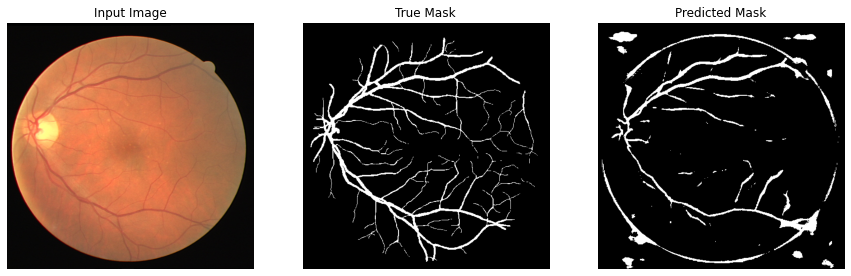


Sample Prediction after epoch 66

Epoch 67/400
3/3 [==============================] - 1s 328ms/step - loss: 0.1950 - accuracy: 0.9670 - dice_coef: 0.4397 - iou: 0.2818 - recall: 0.7885 - precision: 0.8207
Epoch 68/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1930 - accuracy: 0.9672 - dice_coef: 0.4433 - iou: 0.2848 - recall: 0.7898 - precision: 0.8215
Epoch 69/400
3/3 [==============================] - 1s 329ms/step - loss: 0.1916 - accuracy: 0.9671 - dice_coef: 0.4450 - iou: 0.2862 - recall: 0.7883 - precision: 0.8221
Epoch 70/400
3/3 [==============================] - 1s 328ms/step - loss: 0.1900 - accuracy: 0.9672 - dice_coef: 0.4479 - iou: 0.2886 - recall: 0.7905 - precision: 0.8217
Epoch 71/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1877 - accuracy: 0.9676 - dice_coef: 0.4513 - iou: 0.2914 - recall: 0.7925 - precision: 0.8247


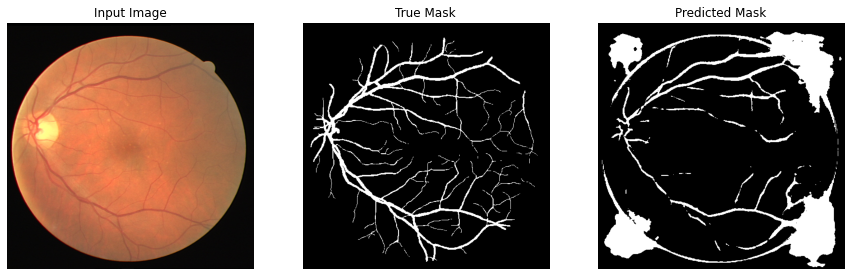


Sample Prediction after epoch 71

Epoch 72/400
3/3 [==============================] - 1s 336ms/step - loss: 0.1858 - accuracy: 0.9679 - dice_coef: 0.4536 - iou: 0.2934 - recall: 0.7929 - precision: 0.8268
Epoch 73/400
3/3 [==============================] - 1s 336ms/step - loss: 0.1840 - accuracy: 0.9682 - dice_coef: 0.4554 - iou: 0.2949 - recall: 0.7924 - precision: 0.8305
Epoch 74/400
3/3 [==============================] - 1s 326ms/step - loss: 0.1822 - accuracy: 0.9683 - dice_coef: 0.4596 - iou: 0.2984 - recall: 0.7972 - precision: 0.8278
Epoch 75/400
3/3 [==============================] - 1s 330ms/step - loss: 0.1808 - accuracy: 0.9683 - dice_coef: 0.4613 - iou: 0.2998 - recall: 0.7942 - precision: 0.8297
Epoch 76/400
3/3 [==============================] - 1s 327ms/step - loss: 0.1796 - accuracy: 0.9682 - dice_coef: 0.4633 - iou: 0.3015 - recall: 0.7925 - precision: 0.8299


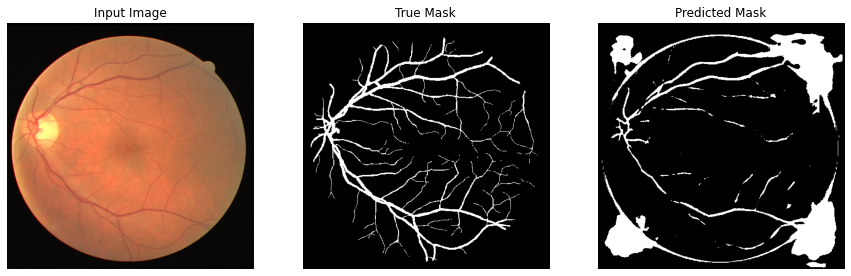


Sample Prediction after epoch 76

Epoch 77/400
3/3 [==============================] - 1s 371ms/step - loss: 0.1777 - accuracy: 0.9686 - dice_coef: 0.4655 - iou: 0.3034 - recall: 0.7958 - precision: 0.8323
Epoch 78/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1759 - accuracy: 0.9689 - dice_coef: 0.4688 - iou: 0.3062 - recall: 0.7963 - precision: 0.8342
Epoch 79/400
3/3 [==============================] - 1s 330ms/step - loss: 0.1747 - accuracy: 0.9687 - dice_coef: 0.4713 - iou: 0.3083 - recall: 0.7980 - precision: 0.8316
Epoch 80/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1729 - accuracy: 0.9692 - dice_coef: 0.4725 - iou: 0.3093 - recall: 0.7955 - precision: 0.8385
Epoch 81/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1713 - accuracy: 0.9692 - dice_coef: 0.4767 - iou: 0.3130 - recall: 0.8023 - precision: 0.8339


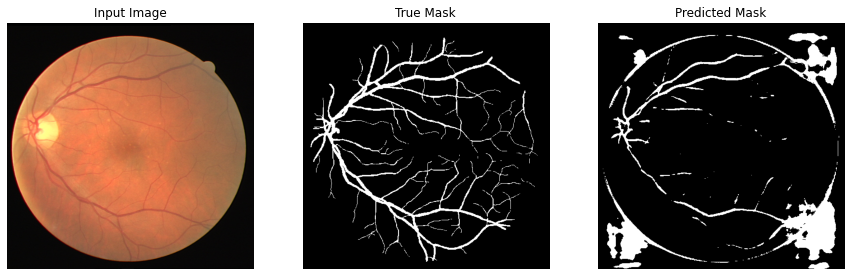


Sample Prediction after epoch 81

Epoch 82/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1698 - accuracy: 0.9696 - dice_coef: 0.4782 - iou: 0.3143 - recall: 0.7981 - precision: 0.8401
Epoch 83/400
3/3 [==============================] - 1s 369ms/step - loss: 0.1686 - accuracy: 0.9693 - dice_coef: 0.4807 - iou: 0.3164 - recall: 0.7977 - precision: 0.8382
Epoch 84/400
3/3 [==============================] - 1s 340ms/step - loss: 0.1666 - accuracy: 0.9699 - dice_coef: 0.4835 - iou: 0.3188 - recall: 0.8031 - precision: 0.8397
Epoch 85/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1663 - accuracy: 0.9695 - dice_coef: 0.4830 - iou: 0.3184 - recall: 0.7950 - precision: 0.8414
Epoch 86/400
3/3 [==============================] - 1s 328ms/step - loss: 0.1638 - accuracy: 0.9700 - dice_coef: 0.4906 - iou: 0.3250 - recall: 0.8086 - precision: 0.8369


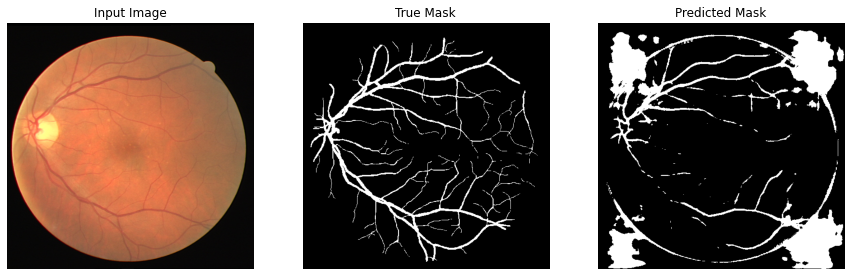


Sample Prediction after epoch 86

Epoch 87/400
3/3 [==============================] - 1s 321ms/step - loss: 0.1625 - accuracy: 0.9704 - dice_coef: 0.4892 - iou: 0.3238 - recall: 0.8015 - precision: 0.8461
Epoch 88/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1610 - accuracy: 0.9704 - dice_coef: 0.4938 - iou: 0.3279 - recall: 0.8056 - precision: 0.8435
Epoch 89/400
3/3 [==============================] - 1s 350ms/step - loss: 0.1600 - accuracy: 0.9705 - dice_coef: 0.4945 - iou: 0.3285 - recall: 0.8045 - precision: 0.8448
Epoch 90/400
3/3 [==============================] - 2s 383ms/step - loss: 0.1588 - accuracy: 0.9705 - dice_coef: 0.4977 - iou: 0.3313 - recall: 0.8044 - precision: 0.8448
Epoch 91/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1580 - accuracy: 0.9704 - dice_coef: 0.4982 - iou: 0.3318 - recall: 0.8033 - precision: 0.8449


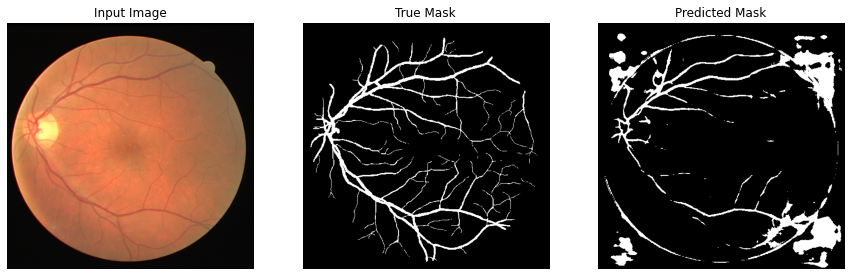


Sample Prediction after epoch 91

Epoch 92/400
3/3 [==============================] - 1s 327ms/step - loss: 0.1556 - accuracy: 0.9711 - dice_coef: 0.5017 - iou: 0.3349 - recall: 0.8070 - precision: 0.8499
Epoch 93/400
3/3 [==============================] - 1s 327ms/step - loss: 0.1545 - accuracy: 0.9711 - dice_coef: 0.5053 - iou: 0.3381 - recall: 0.8106 - precision: 0.8469
Epoch 94/400
3/3 [==============================] - 1s 349ms/step - loss: 0.1537 - accuracy: 0.9710 - dice_coef: 0.5074 - iou: 0.3399 - recall: 0.8098 - precision: 0.8463
Epoch 95/400
3/3 [==============================] - 1s 326ms/step - loss: 0.1524 - accuracy: 0.9713 - dice_coef: 0.5075 - iou: 0.3400 - recall: 0.8050 - precision: 0.8531
Epoch 96/400
3/3 [==============================] - 1s 329ms/step - loss: 0.1511 - accuracy: 0.9713 - dice_coef: 0.5128 - iou: 0.3448 - recall: 0.8150 - precision: 0.8458


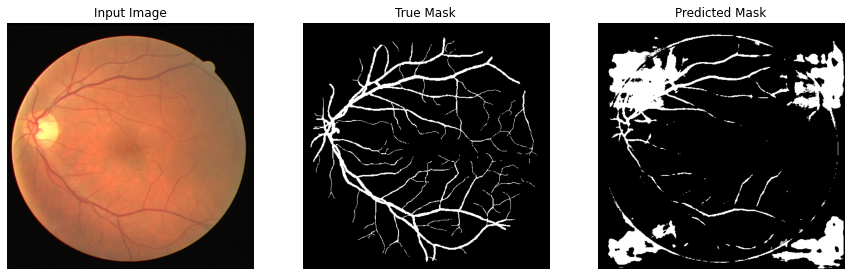


Sample Prediction after epoch 96

Epoch 97/400
3/3 [==============================] - 1s 332ms/step - loss: 0.1502 - accuracy: 0.9715 - dice_coef: 0.5118 - iou: 0.3439 - recall: 0.8063 - precision: 0.8538
Epoch 98/400
3/3 [==============================] - 1s 332ms/step - loss: 0.1496 - accuracy: 0.9712 - dice_coef: 0.5143 - iou: 0.3462 - recall: 0.8074 - precision: 0.8499
Epoch 99/400
3/3 [==============================] - 1s 373ms/step - loss: 0.1478 - accuracy: 0.9717 - dice_coef: 0.5188 - iou: 0.3503 - recall: 0.8146 - precision: 0.8497
Epoch 100/400
3/3 [==============================] - 1s 328ms/step - loss: 0.1468 - accuracy: 0.9717 - dice_coef: 0.5189 - iou: 0.3504 - recall: 0.8099 - precision: 0.8534
Epoch 101/400
3/3 [==============================] - 1s 328ms/step - loss: 0.1450 - accuracy: 0.9723 - dice_coef: 0.5230 - iou: 0.3542 - recall: 0.8140 - precision: 0.8570


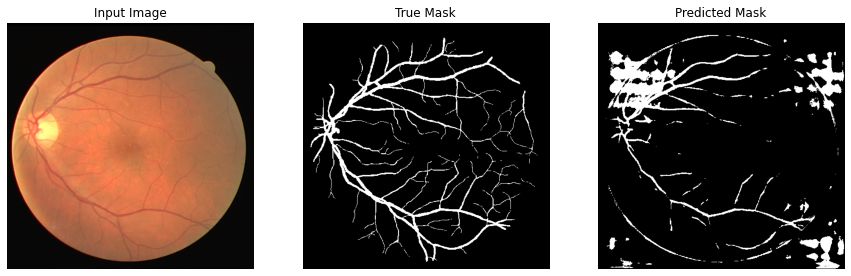


Sample Prediction after epoch 101

Epoch 102/400
3/3 [==============================] - 1s 329ms/step - loss: 0.1443 - accuracy: 0.9722 - dice_coef: 0.5245 - iou: 0.3555 - recall: 0.8151 - precision: 0.8547
Epoch 103/400
3/3 [==============================] - 1s 330ms/step - loss: 0.1436 - accuracy: 0.9721 - dice_coef: 0.5263 - iou: 0.3572 - recall: 0.8145 - precision: 0.8542
Epoch 104/400
3/3 [==============================] - 1s 341ms/step - loss: 0.1421 - accuracy: 0.9726 - dice_coef: 0.5287 - iou: 0.3594 - recall: 0.8189 - precision: 0.8561
Epoch 105/400
3/3 [==============================] - 1s 326ms/step - loss: 0.1416 - accuracy: 0.9722 - dice_coef: 0.5301 - iou: 0.3607 - recall: 0.8134 - precision: 0.8565
Epoch 106/400
3/3 [==============================] - 1s 329ms/step - loss: 0.1406 - accuracy: 0.9724 - dice_coef: 0.5314 - iou: 0.3619 - recall: 0.8138 - precision: 0.8581


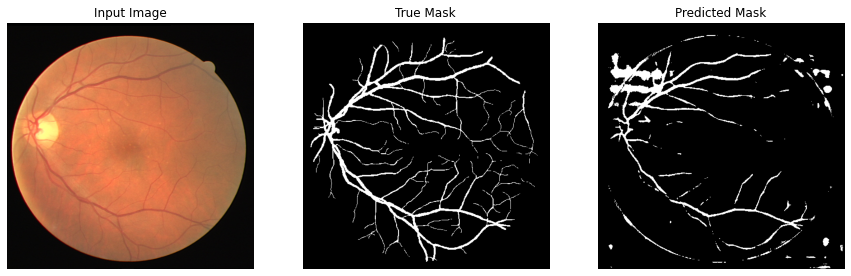


Sample Prediction after epoch 106

Epoch 107/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1392 - accuracy: 0.9727 - dice_coef: 0.5353 - iou: 0.3655 - recall: 0.8216 - precision: 0.8557
Epoch 108/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1382 - accuracy: 0.9728 - dice_coef: 0.5370 - iou: 0.3671 - recall: 0.8188 - precision: 0.8583
Epoch 109/400
3/3 [==============================] - 1s 332ms/step - loss: 0.1371 - accuracy: 0.9730 - dice_coef: 0.5378 - iou: 0.3678 - recall: 0.8174 - precision: 0.8621
Epoch 110/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1358 - accuracy: 0.9732 - dice_coef: 0.5422 - iou: 0.3719 - recall: 0.8217 - precision: 0.8609
Epoch 111/400
3/3 [==============================] - 1s 334ms/step - loss: 0.1348 - accuracy: 0.9735 - dice_coef: 0.5442 - iou: 0.3738 - recall: 0.8252 - precision: 0.8606


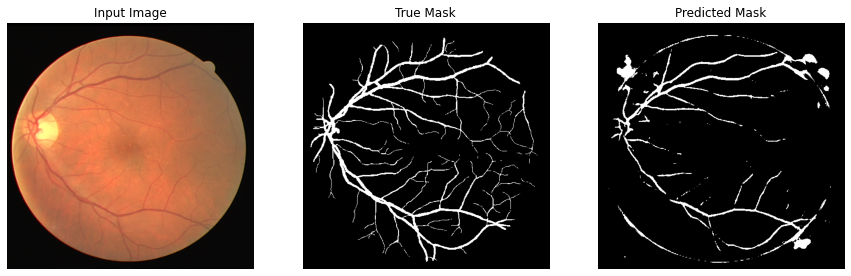


Sample Prediction after epoch 111

Epoch 112/400
3/3 [==============================] - 1s 326ms/step - loss: 0.1338 - accuracy: 0.9736 - dice_coef: 0.5460 - iou: 0.3755 - recall: 0.8238 - precision: 0.8633
Epoch 113/400
3/3 [==============================] - 1s 326ms/step - loss: 0.1328 - accuracy: 0.9736 - dice_coef: 0.5488 - iou: 0.3782 - recall: 0.8253 - precision: 0.8620
Epoch 114/400
3/3 [==============================] - 1s 337ms/step - loss: 0.1325 - accuracy: 0.9734 - dice_coef: 0.5497 - iou: 0.3791 - recall: 0.8218 - precision: 0.8627
Epoch 115/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1319 - accuracy: 0.9736 - dice_coef: 0.5462 - iou: 0.3758 - recall: 0.8154 - precision: 0.8701
Epoch 116/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1302 - accuracy: 0.9739 - dice_coef: 0.5552 - iou: 0.3843 - recall: 0.8326 - precision: 0.8599


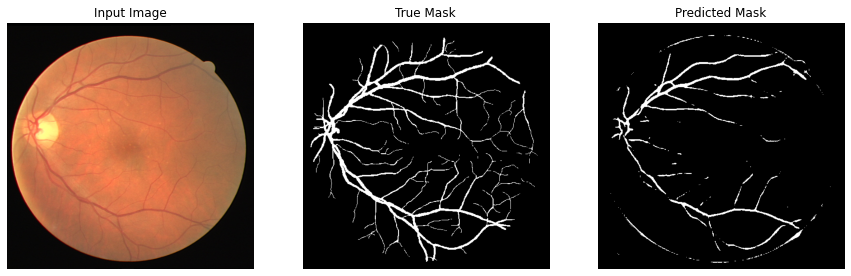


Sample Prediction after epoch 116

Epoch 117/400
3/3 [==============================] - 1s 323ms/step - loss: 0.1292 - accuracy: 0.9741 - dice_coef: 0.5584 - iou: 0.3873 - recall: 0.8335 - precision: 0.8609
Epoch 118/400
3/3 [==============================] - 1s 330ms/step - loss: 0.1288 - accuracy: 0.9740 - dice_coef: 0.5542 - iou: 0.3834 - recall: 0.8173 - precision: 0.8727
Epoch 119/400
3/3 [==============================] - 1s 336ms/step - loss: 0.1274 - accuracy: 0.9743 - dice_coef: 0.5614 - iou: 0.3902 - recall: 0.8330 - precision: 0.8635
Epoch 120/400
3/3 [==============================] - 1s 332ms/step - loss: 0.1267 - accuracy: 0.9745 - dice_coef: 0.5620 - iou: 0.3908 - recall: 0.8303 - precision: 0.8675
Epoch 121/400
3/3 [==============================] - 1s 330ms/step - loss: 0.1253 - accuracy: 0.9748 - dice_coef: 0.5647 - iou: 0.3934 - recall: 0.8312 - precision: 0.8698


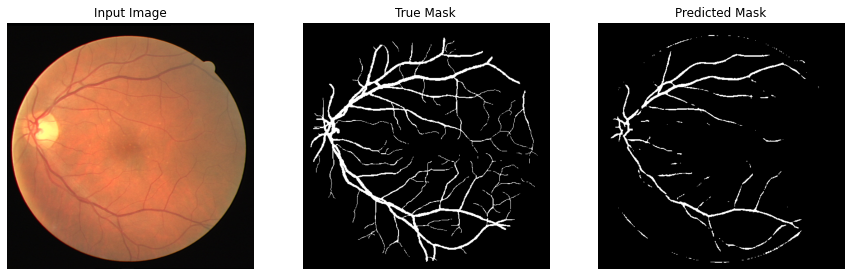


Sample Prediction after epoch 121

Epoch 122/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1250 - accuracy: 0.9747 - dice_coef: 0.5655 - iou: 0.3942 - recall: 0.8309 - precision: 0.8689
Epoch 123/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1243 - accuracy: 0.9746 - dice_coef: 0.5675 - iou: 0.3962 - recall: 0.8304 - precision: 0.8691
Epoch 124/400
3/3 [==============================] - 1s 330ms/step - loss: 0.1236 - accuracy: 0.9747 - dice_coef: 0.5701 - iou: 0.3987 - recall: 0.8314 - precision: 0.8684
Epoch 125/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1229 - accuracy: 0.9749 - dice_coef: 0.5685 - iou: 0.3972 - recall: 0.8264 - precision: 0.8747
Epoch 126/400
3/3 [==============================] - 1s 341ms/step - loss: 0.1223 - accuracy: 0.9748 - dice_coef: 0.5730 - iou: 0.4015 - recall: 0.8323 - precision: 0.8689


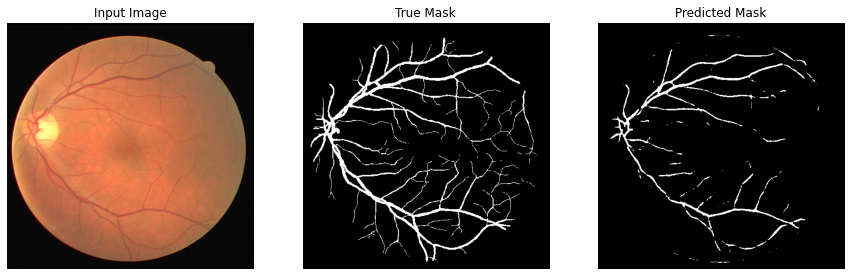


Sample Prediction after epoch 126

Epoch 127/400
3/3 [==============================] - 1s 330ms/step - loss: 0.1208 - accuracy: 0.9751 - dice_coef: 0.5755 - iou: 0.4040 - recall: 0.8354 - precision: 0.8704
Epoch 128/400
3/3 [==============================] - 1s 330ms/step - loss: 0.1202 - accuracy: 0.9753 - dice_coef: 0.5771 - iou: 0.4056 - recall: 0.8351 - precision: 0.8722
Epoch 129/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1187 - accuracy: 0.9758 - dice_coef: 0.5799 - iou: 0.4084 - recall: 0.8376 - precision: 0.8756
Epoch 130/400
3/3 [==============================] - 1s 330ms/step - loss: 0.1194 - accuracy: 0.9750 - dice_coef: 0.5791 - iou: 0.4076 - recall: 0.8324 - precision: 0.8718
Epoch 131/400
3/3 [==============================] - 1s 327ms/step - loss: 0.1173 - accuracy: 0.9760 - dice_coef: 0.5823 - iou: 0.4107 - recall: 0.8380 - precision: 0.8772


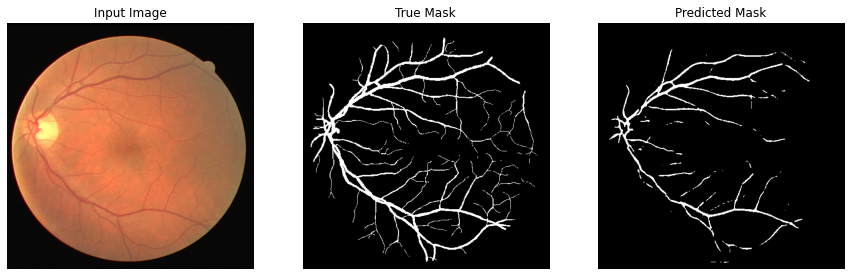


Sample Prediction after epoch 131

Epoch 132/400
3/3 [==============================] - 1s 330ms/step - loss: 0.1169 - accuracy: 0.9757 - dice_coef: 0.5853 - iou: 0.4138 - recall: 0.8386 - precision: 0.8743
Epoch 133/400
3/3 [==============================] - 1s 330ms/step - loss: 0.1157 - accuracy: 0.9761 - dice_coef: 0.5882 - iou: 0.4167 - recall: 0.8431 - precision: 0.8750
Epoch 134/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1146 - accuracy: 0.9765 - dice_coef: 0.5899 - iou: 0.4183 - recall: 0.8427 - precision: 0.8795
Epoch 135/400
3/3 [==============================] - 1s 330ms/step - loss: 0.1147 - accuracy: 0.9760 - dice_coef: 0.5901 - iou: 0.4185 - recall: 0.8390 - precision: 0.8767
Epoch 136/400
3/3 [==============================] - 1s 357ms/step - loss: 0.1140 - accuracy: 0.9763 - dice_coef: 0.5908 - iou: 0.4193 - recall: 0.8391 - precision: 0.8796


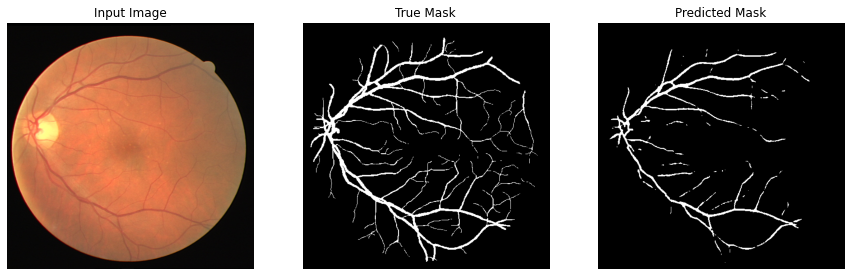


Sample Prediction after epoch 136

Epoch 137/400
3/3 [==============================] - 1s 372ms/step - loss: 0.1135 - accuracy: 0.9762 - dice_coef: 0.5940 - iou: 0.4225 - recall: 0.8424 - precision: 0.8758
Epoch 138/400
3/3 [==============================] - 1s 330ms/step - loss: 0.1118 - accuracy: 0.9769 - dice_coef: 0.5977 - iou: 0.4262 - recall: 0.8482 - precision: 0.8787
Epoch 139/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1120 - accuracy: 0.9766 - dice_coef: 0.5953 - iou: 0.4239 - recall: 0.8376 - precision: 0.8839
Epoch 140/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1112 - accuracy: 0.9765 - dice_coef: 0.5992 - iou: 0.4278 - recall: 0.8436 - precision: 0.8784
Epoch 141/400
3/3 [==============================] - 1s 330ms/step - loss: 0.1110 - accuracy: 0.9766 - dice_coef: 0.5999 - iou: 0.4285 - recall: 0.8420 - precision: 0.8804


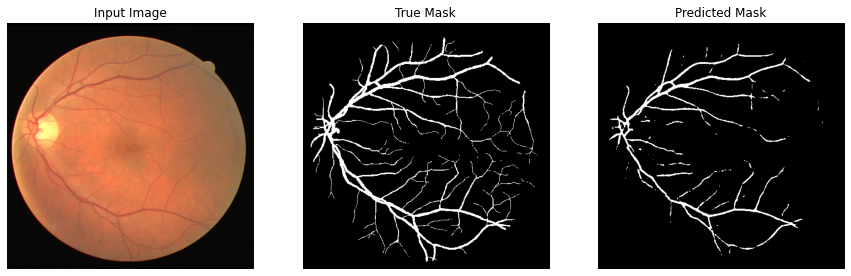


Sample Prediction after epoch 141

Epoch 142/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1105 - accuracy: 0.9765 - dice_coef: 0.6008 - iou: 0.4294 - recall: 0.8404 - precision: 0.8806
Epoch 143/400
3/3 [==============================] - 1s 351ms/step - loss: 0.1082 - accuracy: 0.9774 - dice_coef: 0.6067 - iou: 0.4355 - recall: 0.8524 - precision: 0.8807
Epoch 144/400
3/3 [==============================] - 1s 333ms/step - loss: 0.1083 - accuracy: 0.9770 - dice_coef: 0.6054 - iou: 0.4341 - recall: 0.8445 - precision: 0.8834
Epoch 145/400
3/3 [==============================] - 1s 330ms/step - loss: 0.1069 - accuracy: 0.9777 - dice_coef: 0.6086 - iou: 0.4374 - recall: 0.8498 - precision: 0.8859
Epoch 146/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1074 - accuracy: 0.9770 - dice_coef: 0.6104 - iou: 0.4392 - recall: 0.8486 - precision: 0.8795


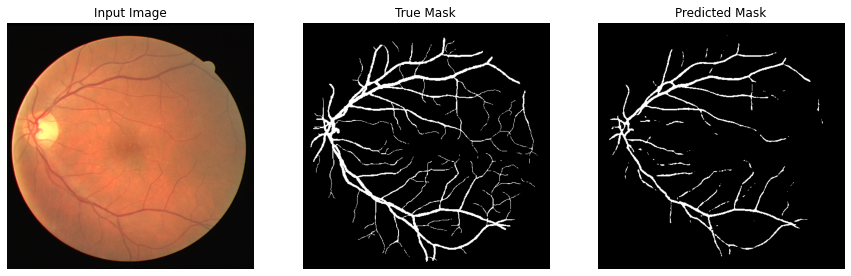


Sample Prediction after epoch 146

Epoch 147/400
3/3 [==============================] - 1s 323ms/step - loss: 0.1069 - accuracy: 0.9771 - dice_coef: 0.6085 - iou: 0.4373 - recall: 0.8403 - precision: 0.8877
Epoch 148/400
3/3 [==============================] - 1s 328ms/step - loss: 0.1059 - accuracy: 0.9773 - dice_coef: 0.6131 - iou: 0.4421 - recall: 0.8500 - precision: 0.8819
Epoch 149/400
3/3 [==============================] - 1s 333ms/step - loss: 0.1056 - accuracy: 0.9773 - dice_coef: 0.6126 - iou: 0.4416 - recall: 0.8449 - precision: 0.8857
Epoch 150/400
3/3 [==============================] - 1s 332ms/step - loss: 0.1051 - accuracy: 0.9772 - dice_coef: 0.6165 - iou: 0.4456 - recall: 0.8521 - precision: 0.8789
Epoch 151/400
3/3 [==============================] - 1s 336ms/step - loss: 0.1036 - accuracy: 0.9779 - dice_coef: 0.6174 - iou: 0.4466 - recall: 0.8493 - precision: 0.8890


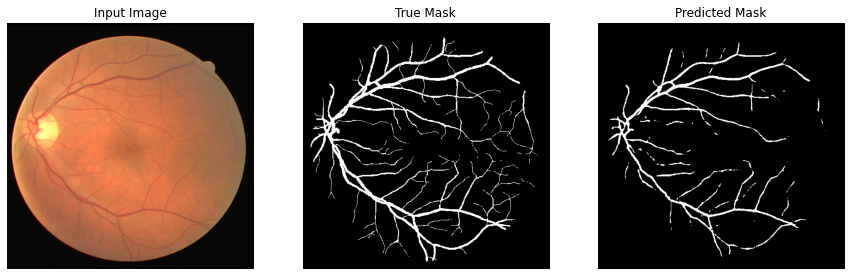


Sample Prediction after epoch 151

Epoch 152/400
3/3 [==============================] - 1s 331ms/step - loss: 0.1031 - accuracy: 0.9779 - dice_coef: 0.6189 - iou: 0.4481 - recall: 0.8496 - precision: 0.8889
Epoch 153/400
3/3 [==============================] - 1s 330ms/step - loss: 0.1023 - accuracy: 0.9780 - dice_coef: 0.6224 - iou: 0.4518 - recall: 0.8550 - precision: 0.8858
Epoch 154/400
3/3 [==============================] - 1s 330ms/step - loss: 0.1024 - accuracy: 0.9778 - dice_coef: 0.6220 - iou: 0.4514 - recall: 0.8474 - precision: 0.8891
Epoch 155/400
3/3 [==============================] - 1s 335ms/step - loss: 0.1011 - accuracy: 0.9782 - dice_coef: 0.6260 - iou: 0.4556 - recall: 0.8581 - precision: 0.8853
Epoch 156/400
3/3 [==============================] - 2s 364ms/step - loss: 0.1017 - accuracy: 0.9777 - dice_coef: 0.6244 - iou: 0.4540 - recall: 0.8477 - precision: 0.8885


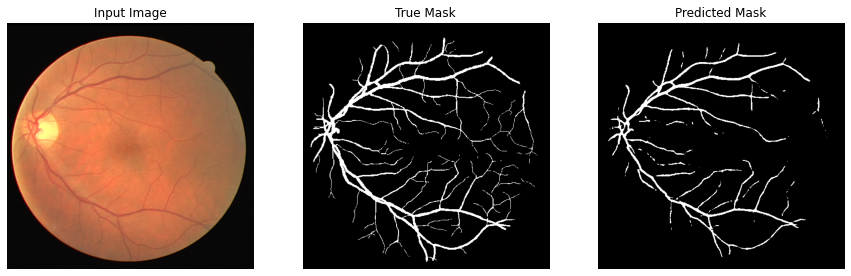


Sample Prediction after epoch 156

Epoch 157/400
3/3 [==============================] - 1s 343ms/step - loss: 0.0999 - accuracy: 0.9785 - dice_coef: 0.6280 - iou: 0.4577 - recall: 0.8546 - precision: 0.8910
Epoch 158/400
3/3 [==============================] - 1s 329ms/step - loss: 0.1001 - accuracy: 0.9781 - dice_coef: 0.6297 - iou: 0.4595 - recall: 0.8570 - precision: 0.8849
Epoch 159/400
3/3 [==============================] - 1s 321ms/step - loss: 0.0985 - accuracy: 0.9789 - dice_coef: 0.6312 - iou: 0.4611 - recall: 0.8554 - precision: 0.8950
Epoch 160/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0976 - accuracy: 0.9791 - dice_coef: 0.6350 - iou: 0.4652 - recall: 0.8617 - precision: 0.8919
Epoch 161/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0976 - accuracy: 0.9789 - dice_coef: 0.6338 - iou: 0.4640 - recall: 0.8560 - precision: 0.8940


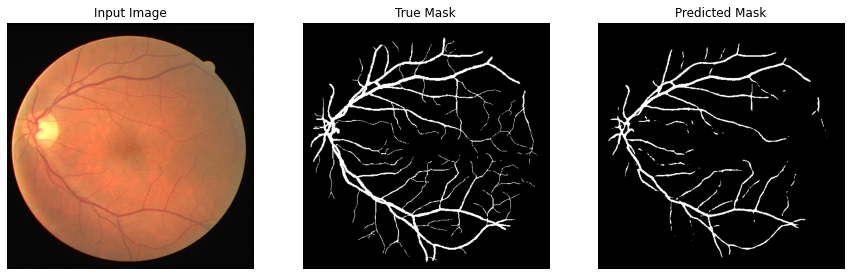


Sample Prediction after epoch 161

Epoch 162/400
3/3 [==============================] - 1s 356ms/step - loss: 0.0966 - accuracy: 0.9792 - dice_coef: 0.6368 - iou: 0.4671 - recall: 0.8613 - precision: 0.8929
Epoch 163/400
3/3 [==============================] - 1s 322ms/step - loss: 0.0966 - accuracy: 0.9789 - dice_coef: 0.6398 - iou: 0.4704 - recall: 0.8636 - precision: 0.8884
Epoch 164/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0955 - accuracy: 0.9794 - dice_coef: 0.6387 - iou: 0.4692 - recall: 0.8575 - precision: 0.8989
Epoch 165/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0945 - accuracy: 0.9798 - dice_coef: 0.6420 - iou: 0.4728 - recall: 0.8634 - precision: 0.8984
Epoch 166/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0953 - accuracy: 0.9790 - dice_coef: 0.6420 - iou: 0.4728 - recall: 0.8619 - precision: 0.8902


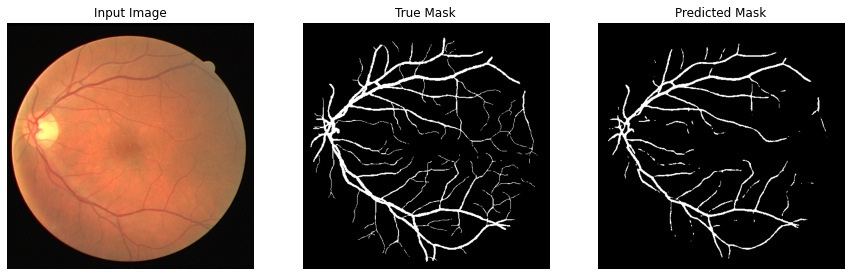


Sample Prediction after epoch 166

Epoch 167/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0946 - accuracy: 0.9793 - dice_coef: 0.6411 - iou: 0.4718 - recall: 0.8567 - precision: 0.8977
Epoch 168/400
3/3 [==============================] - 1s 323ms/step - loss: 0.0930 - accuracy: 0.9799 - dice_coef: 0.6480 - iou: 0.4793 - recall: 0.8690 - precision: 0.8943
Epoch 169/400
3/3 [==============================] - 1s 323ms/step - loss: 0.0934 - accuracy: 0.9794 - dice_coef: 0.6463 - iou: 0.4775 - recall: 0.8616 - precision: 0.8954
Epoch 170/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0930 - accuracy: 0.9794 - dice_coef: 0.6467 - iou: 0.4779 - recall: 0.8585 - precision: 0.8979
Epoch 171/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0920 - accuracy: 0.9798 - dice_coef: 0.6502 - iou: 0.4818 - recall: 0.8666 - precision: 0.8952


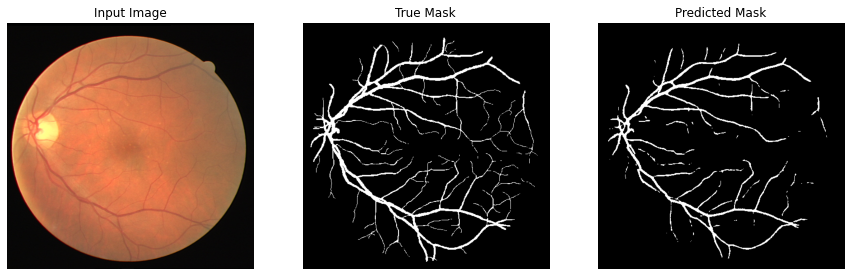


Sample Prediction after epoch 171

Epoch 172/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0919 - accuracy: 0.9797 - dice_coef: 0.6508 - iou: 0.4824 - recall: 0.8637 - precision: 0.8963
Epoch 173/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0916 - accuracy: 0.9796 - dice_coef: 0.6515 - iou: 0.4832 - recall: 0.8615 - precision: 0.8973
Epoch 174/400
3/3 [==============================] - 1s 326ms/step - loss: 0.0900 - accuracy: 0.9803 - dice_coef: 0.6549 - iou: 0.4869 - recall: 0.8671 - precision: 0.9000
Epoch 175/400
3/3 [==============================] - 1s 326ms/step - loss: 0.0902 - accuracy: 0.9800 - dice_coef: 0.6563 - iou: 0.4885 - recall: 0.8687 - precision: 0.8955
Epoch 176/400
3/3 [==============================] - 1s 332ms/step - loss: 0.0895 - accuracy: 0.9803 - dice_coef: 0.6563 - iou: 0.4885 - recall: 0.8642 - precision: 0.9030


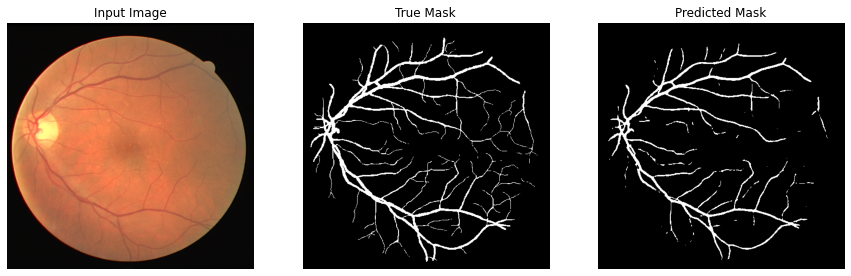


Sample Prediction after epoch 176

Epoch 177/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0882 - accuracy: 0.9808 - dice_coef: 0.6603 - iou: 0.4929 - recall: 0.8731 - precision: 0.9007
Epoch 178/400
3/3 [==============================] - 1s 331ms/step - loss: 0.0881 - accuracy: 0.9806 - dice_coef: 0.6613 - iou: 0.4940 - recall: 0.8697 - precision: 0.9015
Epoch 179/400
3/3 [==============================] - 1s 324ms/step - loss: 0.0879 - accuracy: 0.9807 - dice_coef: 0.6623 - iou: 0.4951 - recall: 0.8711 - precision: 0.9014
Epoch 180/400
3/3 [==============================] - 1s 335ms/step - loss: 0.0868 - accuracy: 0.9811 - dice_coef: 0.6645 - iou: 0.4976 - recall: 0.8735 - precision: 0.9032
Epoch 181/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0870 - accuracy: 0.9807 - dice_coef: 0.6643 - iou: 0.4974 - recall: 0.8672 - precision: 0.9045


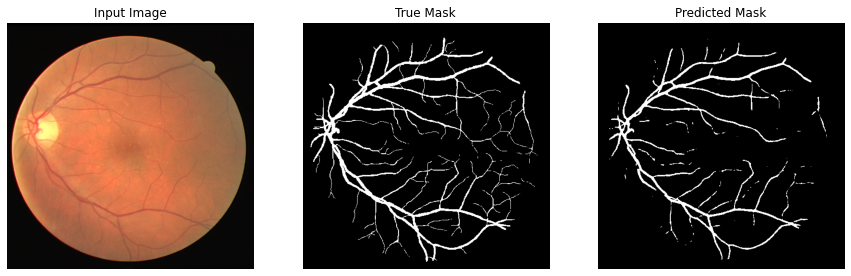


Sample Prediction after epoch 181

Epoch 182/400
3/3 [==============================] - 1s 332ms/step - loss: 0.0869 - accuracy: 0.9805 - dice_coef: 0.6657 - iou: 0.4990 - recall: 0.8697 - precision: 0.9004
Epoch 183/400
3/3 [==============================] - 1s 332ms/step - loss: 0.0862 - accuracy: 0.9807 - dice_coef: 0.6673 - iou: 0.5007 - recall: 0.8713 - precision: 0.9011
Epoch 184/400
3/3 [==============================] - 1s 343ms/step - loss: 0.0860 - accuracy: 0.9807 - dice_coef: 0.6661 - iou: 0.4994 - recall: 0.8671 - precision: 0.9044
Epoch 185/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0848 - accuracy: 0.9812 - dice_coef: 0.6712 - iou: 0.5051 - recall: 0.8756 - precision: 0.9032
Epoch 186/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0856 - accuracy: 0.9807 - dice_coef: 0.6702 - iou: 0.5040 - recall: 0.8702 - precision: 0.9019


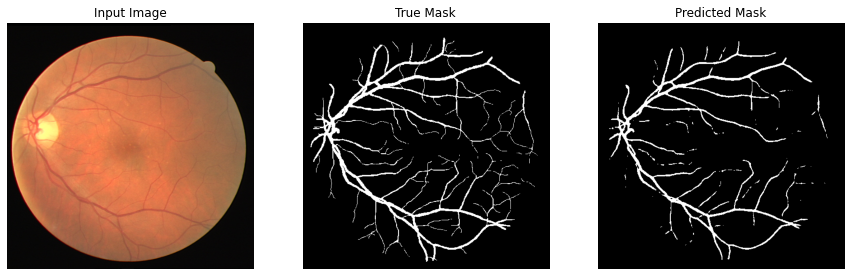


Sample Prediction after epoch 186

Epoch 187/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0838 - accuracy: 0.9815 - dice_coef: 0.6736 - iou: 0.5079 - recall: 0.8767 - precision: 0.9055
Epoch 188/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0839 - accuracy: 0.9811 - dice_coef: 0.6741 - iou: 0.5084 - recall: 0.8723 - precision: 0.9046
Epoch 189/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0836 - accuracy: 0.9812 - dice_coef: 0.6746 - iou: 0.5090 - recall: 0.8724 - precision: 0.9054
Epoch 190/400
3/3 [==============================] - 1s 374ms/step - loss: 0.0829 - accuracy: 0.9813 - dice_coef: 0.6766 - iou: 0.5112 - recall: 0.8752 - precision: 0.9049
Epoch 191/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0817 - accuracy: 0.9820 - dice_coef: 0.6792 - iou: 0.5142 - recall: 0.8791 - precision: 0.9088


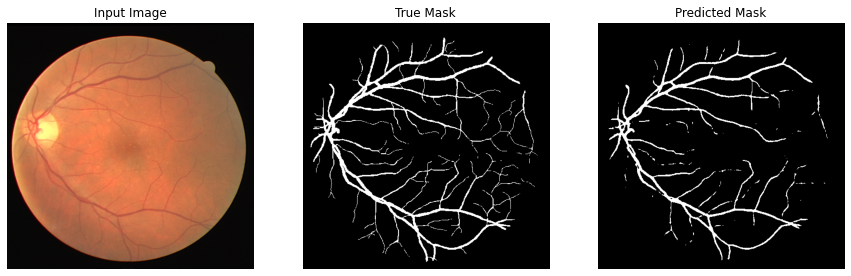


Sample Prediction after epoch 191

Epoch 192/400
3/3 [==============================] - 1s 325ms/step - loss: 0.0825 - accuracy: 0.9813 - dice_coef: 0.6787 - iou: 0.5137 - recall: 0.8752 - precision: 0.9039
Epoch 193/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0814 - accuracy: 0.9818 - dice_coef: 0.6805 - iou: 0.5157 - recall: 0.8758 - precision: 0.9097
Epoch 194/400
3/3 [==============================] - 1s 327ms/step - loss: 0.0807 - accuracy: 0.9820 - dice_coef: 0.6828 - iou: 0.5184 - recall: 0.8799 - precision: 0.9077
Epoch 195/400
3/3 [==============================] - 1s 351ms/step - loss: 0.0809 - accuracy: 0.9816 - dice_coef: 0.6829 - iou: 0.5185 - recall: 0.8776 - precision: 0.9057
Epoch 196/400
3/3 [==============================] - 1s 326ms/step - loss: 0.0802 - accuracy: 0.9820 - dice_coef: 0.6839 - iou: 0.5196 - recall: 0.8765 - precision: 0.9106


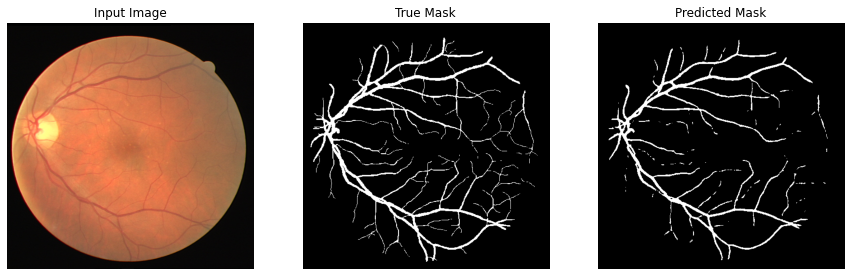


Sample Prediction after epoch 196

Epoch 197/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0813 - accuracy: 0.9812 - dice_coef: 0.6840 - iou: 0.5198 - recall: 0.8737 - precision: 0.9050
Epoch 198/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0796 - accuracy: 0.9819 - dice_coef: 0.6873 - iou: 0.5236 - recall: 0.8819 - precision: 0.9057
Epoch 199/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0791 - accuracy: 0.9821 - dice_coef: 0.6880 - iou: 0.5244 - recall: 0.8778 - precision: 0.9105
Epoch 200/400
3/3 [==============================] - 1s 326ms/step - loss: 0.0784 - accuracy: 0.9824 - dice_coef: 0.6904 - iou: 0.5273 - recall: 0.8826 - precision: 0.9096
Epoch 201/400
3/3 [==============================] - 1s 340ms/step - loss: 0.0796 - accuracy: 0.9813 - dice_coef: 0.6880 - iou: 0.5245 - recall: 0.8715 - precision: 0.9071


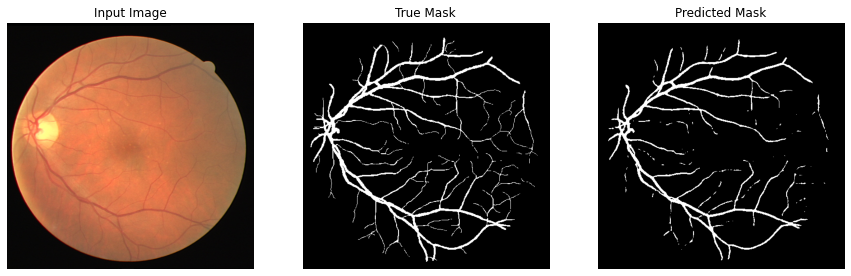


Sample Prediction after epoch 201

Epoch 202/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0785 - accuracy: 0.9819 - dice_coef: 0.6902 - iou: 0.5269 - recall: 0.8786 - precision: 0.9076
Epoch 203/400
3/3 [==============================] - 1s 320ms/step - loss: 0.0772 - accuracy: 0.9826 - dice_coef: 0.6935 - iou: 0.5309 - recall: 0.8833 - precision: 0.9116
Epoch 204/400
3/3 [==============================] - 1s 327ms/step - loss: 0.0771 - accuracy: 0.9824 - dice_coef: 0.6939 - iou: 0.5313 - recall: 0.8820 - precision: 0.9101
Epoch 205/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0776 - accuracy: 0.9820 - dice_coef: 0.6940 - iou: 0.5314 - recall: 0.8782 - precision: 0.9096
Epoch 206/400
3/3 [==============================] - 1s 331ms/step - loss: 0.0766 - accuracy: 0.9823 - dice_coef: 0.6962 - iou: 0.5340 - recall: 0.8817 - precision: 0.9099


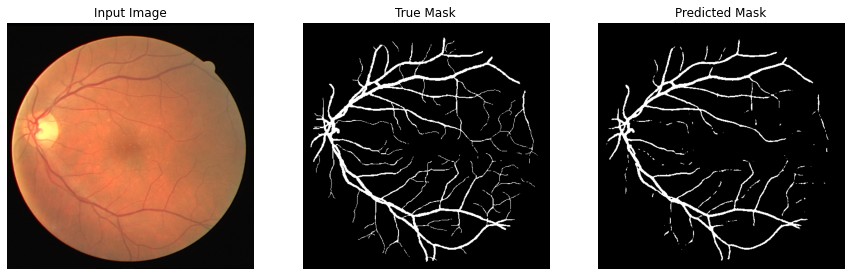


Sample Prediction after epoch 206

Epoch 207/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0755 - accuracy: 0.9830 - dice_coef: 0.6990 - iou: 0.5373 - recall: 0.8880 - precision: 0.9122
Epoch 208/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0749 - accuracy: 0.9832 - dice_coef: 0.7004 - iou: 0.5390 - recall: 0.8858 - precision: 0.9165
Epoch 209/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0749 - accuracy: 0.9830 - dice_coef: 0.7011 - iou: 0.5398 - recall: 0.8866 - precision: 0.9130
Epoch 210/400
3/3 [==============================] - 1s 335ms/step - loss: 0.0740 - accuracy: 0.9834 - dice_coef: 0.7037 - iou: 0.5428 - recall: 0.8889 - precision: 0.9154
Epoch 211/400
3/3 [==============================] - 1s 327ms/step - loss: 0.0743 - accuracy: 0.9831 - dice_coef: 0.7034 - iou: 0.5425 - recall: 0.8864 - precision: 0.9148


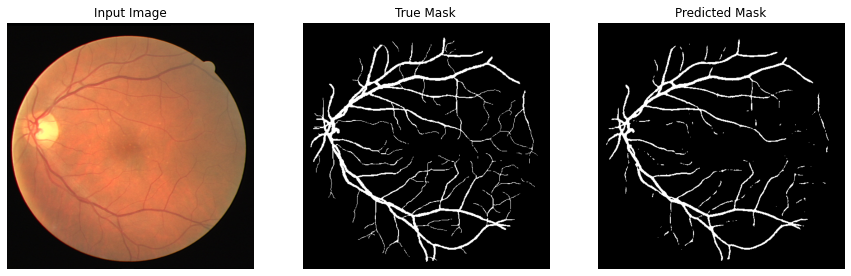


Sample Prediction after epoch 211

Epoch 212/400
3/3 [==============================] - 1s 332ms/step - loss: 0.0738 - accuracy: 0.9832 - dice_coef: 0.7047 - iou: 0.5441 - recall: 0.8877 - precision: 0.9145
Epoch 213/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0731 - accuracy: 0.9835 - dice_coef: 0.7065 - iou: 0.5462 - recall: 0.8903 - precision: 0.9153
Epoch 214/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0729 - accuracy: 0.9834 - dice_coef: 0.7072 - iou: 0.5471 - recall: 0.8878 - precision: 0.9172
Epoch 215/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0724 - accuracy: 0.9836 - dice_coef: 0.7089 - iou: 0.5491 - recall: 0.8914 - precision: 0.9162
Epoch 216/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0731 - accuracy: 0.9831 - dice_coef: 0.7073 - iou: 0.5471 - recall: 0.8866 - precision: 0.9144


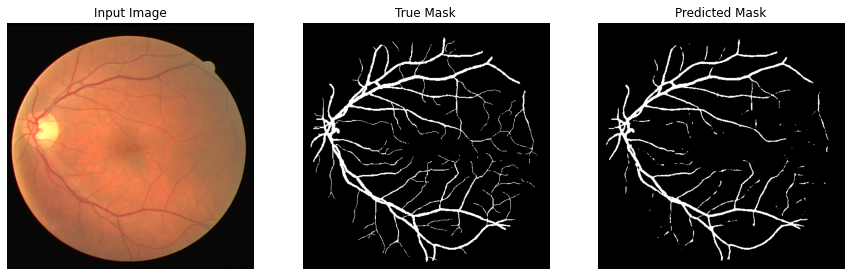


Sample Prediction after epoch 216

Epoch 217/400
3/3 [==============================] - 1s 336ms/step - loss: 0.0724 - accuracy: 0.9833 - dice_coef: 0.7098 - iou: 0.5502 - recall: 0.8885 - precision: 0.9149
Epoch 218/400
3/3 [==============================] - 1s 332ms/step - loss: 0.0719 - accuracy: 0.9835 - dice_coef: 0.7113 - iou: 0.5520 - recall: 0.8884 - precision: 0.9168
Epoch 219/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0718 - accuracy: 0.9833 - dice_coef: 0.7104 - iou: 0.5509 - recall: 0.8871 - precision: 0.9165
Epoch 220/400
3/3 [==============================] - 1s 333ms/step - loss: 0.0718 - accuracy: 0.9833 - dice_coef: 0.7129 - iou: 0.5539 - recall: 0.8893 - precision: 0.9140
Epoch 221/400
3/3 [==============================] - 1s 331ms/step - loss: 0.0714 - accuracy: 0.9832 - dice_coef: 0.7131 - iou: 0.5542 - recall: 0.8866 - precision: 0.9156


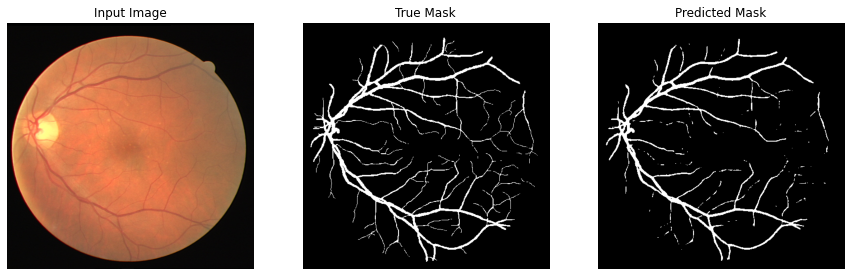


Sample Prediction after epoch 221

Epoch 222/400
3/3 [==============================] - 1s 354ms/step - loss: 0.0700 - accuracy: 0.9840 - dice_coef: 0.7169 - iou: 0.5587 - recall: 0.8943 - precision: 0.9175
Epoch 223/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0702 - accuracy: 0.9837 - dice_coef: 0.7167 - iou: 0.5585 - recall: 0.8910 - precision: 0.9176
Epoch 224/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0699 - accuracy: 0.9840 - dice_coef: 0.7177 - iou: 0.5597 - recall: 0.8916 - precision: 0.9197
Epoch 225/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0698 - accuracy: 0.9836 - dice_coef: 0.7181 - iou: 0.5602 - recall: 0.8926 - precision: 0.9148
Epoch 226/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0688 - accuracy: 0.9843 - dice_coef: 0.7207 - iou: 0.5634 - recall: 0.8941 - precision: 0.9206


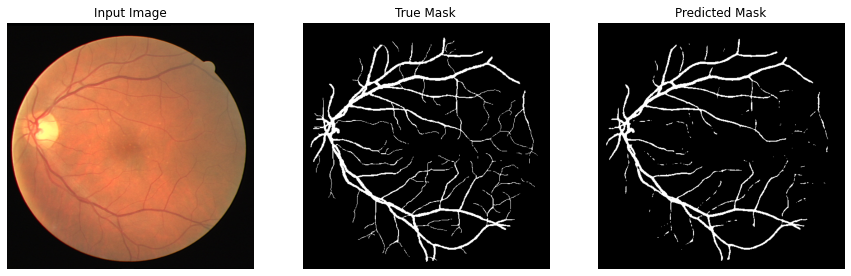


Sample Prediction after epoch 226

Epoch 227/400
3/3 [==============================] - 1s 360ms/step - loss: 0.0690 - accuracy: 0.9839 - dice_coef: 0.7205 - iou: 0.5631 - recall: 0.8914 - precision: 0.9194
Epoch 228/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0675 - accuracy: 0.9847 - dice_coef: 0.7242 - iou: 0.5676 - recall: 0.9002 - precision: 0.9207
Epoch 229/400
3/3 [==============================] - 1s 332ms/step - loss: 0.0687 - accuracy: 0.9838 - dice_coef: 0.7214 - iou: 0.5642 - recall: 0.8896 - precision: 0.9199
Epoch 230/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0682 - accuracy: 0.9840 - dice_coef: 0.7222 - iou: 0.5652 - recall: 0.8931 - precision: 0.9187
Epoch 231/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0676 - accuracy: 0.9842 - dice_coef: 0.7255 - iou: 0.5693 - recall: 0.8980 - precision: 0.9165


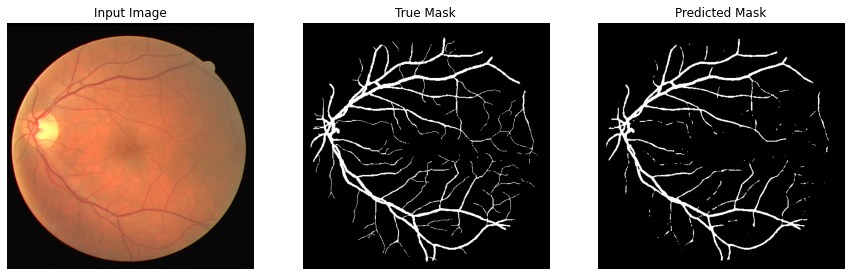


Sample Prediction after epoch 231

Epoch 232/400
3/3 [==============================] - 1s 333ms/step - loss: 0.0663 - accuracy: 0.9850 - dice_coef: 0.7279 - iou: 0.5723 - recall: 0.8995 - precision: 0.9245
Epoch 233/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0667 - accuracy: 0.9845 - dice_coef: 0.7274 - iou: 0.5716 - recall: 0.8953 - precision: 0.9221
Epoch 234/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0666 - accuracy: 0.9844 - dice_coef: 0.7286 - iou: 0.5731 - recall: 0.8980 - precision: 0.9194
Epoch 235/400
3/3 [==============================] - 2s 417ms/step - loss: 0.0669 - accuracy: 0.9841 - dice_coef: 0.7272 - iou: 0.5713 - recall: 0.8918 - precision: 0.9210
Epoch 236/400
3/3 [==============================] - 1s 324ms/step - loss: 0.0660 - accuracy: 0.9846 - dice_coef: 0.7306 - iou: 0.5756 - recall: 0.8977 - precision: 0.9211


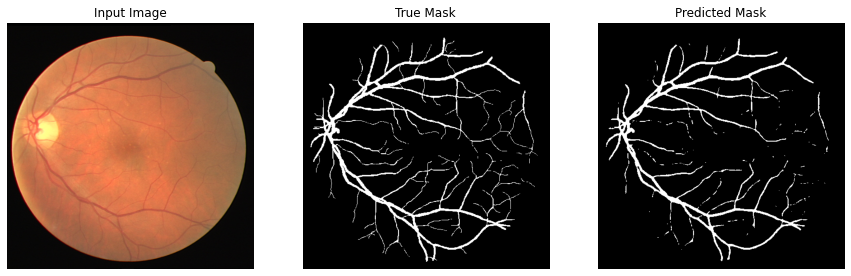


Sample Prediction after epoch 236

Epoch 237/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0650 - accuracy: 0.9851 - dice_coef: 0.7334 - iou: 0.5791 - recall: 0.9046 - precision: 0.9213
Epoch 238/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0654 - accuracy: 0.9847 - dice_coef: 0.7314 - iou: 0.5766 - recall: 0.8960 - precision: 0.9238
Epoch 239/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0645 - accuracy: 0.9851 - dice_coef: 0.7352 - iou: 0.5813 - recall: 0.9032 - precision: 0.9224
Epoch 240/400
3/3 [==============================] - 1s 331ms/step - loss: 0.0654 - accuracy: 0.9845 - dice_coef: 0.7338 - iou: 0.5796 - recall: 0.8944 - precision: 0.9227
Epoch 241/400
3/3 [==============================] - 1s 323ms/step - loss: 0.0649 - accuracy: 0.9846 - dice_coef: 0.7324 - iou: 0.5778 - recall: 0.8988 - precision: 0.9204


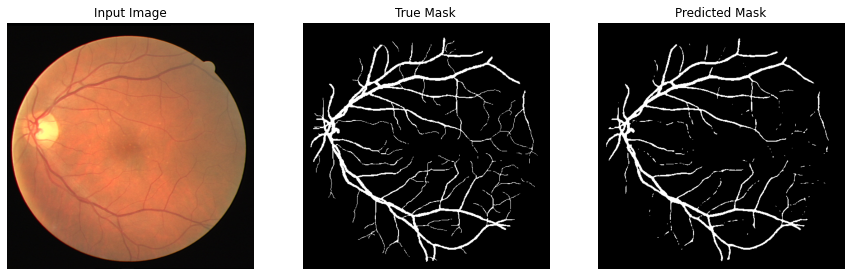


Sample Prediction after epoch 241

Epoch 242/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0637 - accuracy: 0.9853 - dice_coef: 0.7376 - iou: 0.5843 - recall: 0.9024 - precision: 0.9245
Epoch 243/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0635 - accuracy: 0.9853 - dice_coef: 0.7381 - iou: 0.5850 - recall: 0.9049 - precision: 0.9225
Epoch 244/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0639 - accuracy: 0.9849 - dice_coef: 0.7378 - iou: 0.5846 - recall: 0.8968 - precision: 0.9253
Epoch 245/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0634 - accuracy: 0.9851 - dice_coef: 0.7401 - iou: 0.5874 - recall: 0.9022 - precision: 0.9233
Epoch 246/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0637 - accuracy: 0.9848 - dice_coef: 0.7391 - iou: 0.5862 - recall: 0.8996 - precision: 0.9215


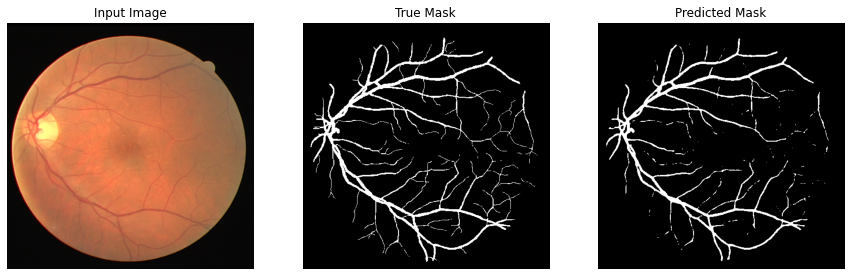


Sample Prediction after epoch 246

Epoch 247/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0620 - accuracy: 0.9858 - dice_coef: 0.7427 - iou: 0.5908 - recall: 0.9047 - precision: 0.9283
Epoch 248/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0630 - accuracy: 0.9849 - dice_coef: 0.7409 - iou: 0.5885 - recall: 0.8985 - precision: 0.9244
Epoch 249/400
3/3 [==============================] - 1s 333ms/step - loss: 0.0622 - accuracy: 0.9853 - dice_coef: 0.7441 - iou: 0.5926 - recall: 0.9062 - precision: 0.9220
Epoch 250/400
3/3 [==============================] - 1s 333ms/step - loss: 0.0631 - accuracy: 0.9848 - dice_coef: 0.7428 - iou: 0.5909 - recall: 0.8967 - precision: 0.9246
Epoch 251/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0630 - accuracy: 0.9844 - dice_coef: 0.7401 - iou: 0.5875 - recall: 0.8945 - precision: 0.9220


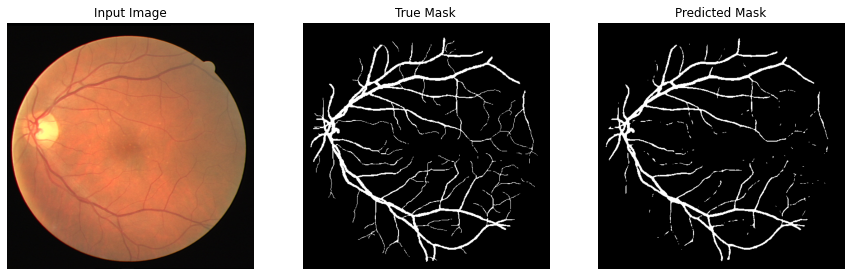


Sample Prediction after epoch 251

Epoch 252/400
3/3 [==============================] - 1s 344ms/step - loss: 0.0615 - accuracy: 0.9857 - dice_coef: 0.7461 - iou: 0.5950 - recall: 0.9076 - precision: 0.9243
Epoch 253/400
3/3 [==============================] - 1s 332ms/step - loss: 0.0609 - accuracy: 0.9856 - dice_coef: 0.7481 - iou: 0.5976 - recall: 0.9056 - precision: 0.9257
Epoch 254/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0621 - accuracy: 0.9849 - dice_coef: 0.7462 - iou: 0.5952 - recall: 0.8972 - precision: 0.9246
Epoch 255/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0613 - accuracy: 0.9852 - dice_coef: 0.7473 - iou: 0.5966 - recall: 0.9012 - precision: 0.9247
Epoch 256/400
3/3 [==============================] - 1s 325ms/step - loss: 0.0608 - accuracy: 0.9854 - dice_coef: 0.7496 - iou: 0.5995 - recall: 0.9044 - precision: 0.9247


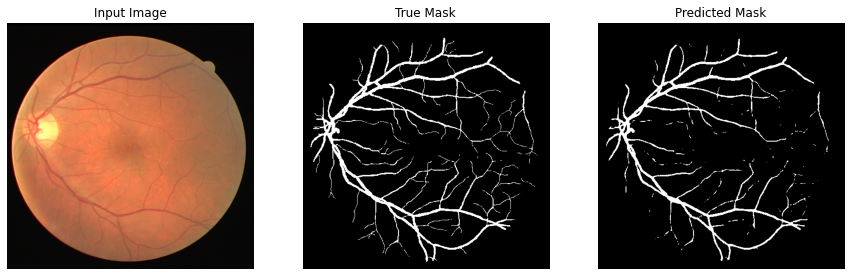


Sample Prediction after epoch 256

Epoch 257/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0601 - accuracy: 0.9858 - dice_coef: 0.7509 - iou: 0.6012 - recall: 0.9075 - precision: 0.9263
Epoch 258/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0595 - accuracy: 0.9860 - dice_coef: 0.7528 - iou: 0.6036 - recall: 0.9070 - precision: 0.9289
Epoch 259/400
3/3 [==============================] - 1s 337ms/step - loss: 0.0591 - accuracy: 0.9861 - dice_coef: 0.7535 - iou: 0.6045 - recall: 0.9083 - precision: 0.9287
Epoch 260/400
3/3 [==============================] - 1s 320ms/step - loss: 0.0591 - accuracy: 0.9860 - dice_coef: 0.7528 - iou: 0.6036 - recall: 0.9061 - precision: 0.9299
Epoch 261/400
3/3 [==============================] - 1s 326ms/step - loss: 0.0584 - accuracy: 0.9865 - dice_coef: 0.7564 - iou: 0.6082 - recall: 0.9143 - precision: 0.9277


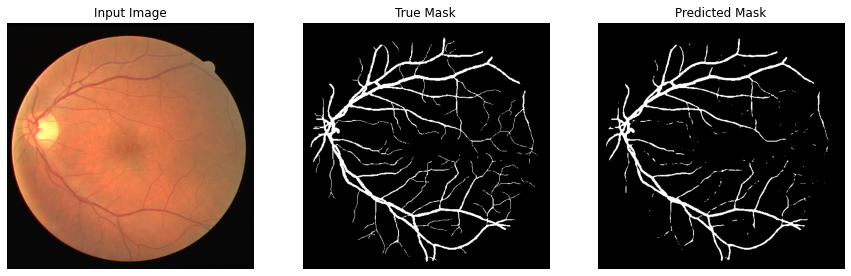


Sample Prediction after epoch 261

Epoch 262/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0581 - accuracy: 0.9866 - dice_coef: 0.7568 - iou: 0.6088 - recall: 0.9097 - precision: 0.9324
Epoch 263/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0582 - accuracy: 0.9863 - dice_coef: 0.7568 - iou: 0.6088 - recall: 0.9095 - precision: 0.9298
Epoch 264/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0584 - accuracy: 0.9861 - dice_coef: 0.7573 - iou: 0.6095 - recall: 0.9077 - precision: 0.9290
Epoch 265/400
3/3 [==============================] - 1s 348ms/step - loss: 0.0584 - accuracy: 0.9859 - dice_coef: 0.7564 - iou: 0.6082 - recall: 0.9076 - precision: 0.9272
Epoch 266/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0567 - accuracy: 0.9870 - dice_coef: 0.7615 - iou: 0.6149 - recall: 0.9156 - precision: 0.9320


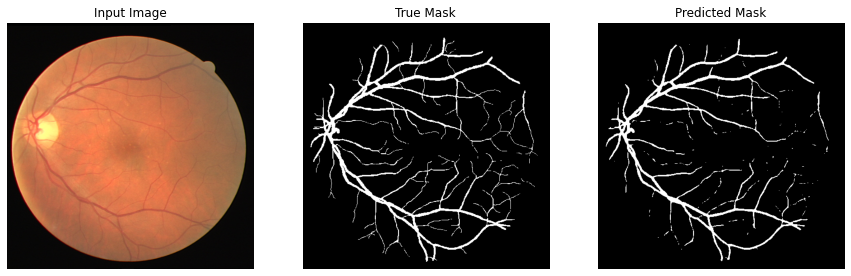


Sample Prediction after epoch 266

Epoch 267/400
3/3 [==============================] - 1s 331ms/step - loss: 0.0577 - accuracy: 0.9861 - dice_coef: 0.7592 - iou: 0.6120 - recall: 0.9078 - precision: 0.9296
Epoch 268/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0571 - accuracy: 0.9865 - dice_coef: 0.7617 - iou: 0.6151 - recall: 0.9126 - precision: 0.9292
Epoch 269/400
3/3 [==============================] - 1s 362ms/step - loss: 0.0576 - accuracy: 0.9861 - dice_coef: 0.7609 - iou: 0.6141 - recall: 0.9077 - precision: 0.9294
Epoch 270/400
3/3 [==============================] - 1s 336ms/step - loss: 0.0561 - accuracy: 0.9870 - dice_coef: 0.7637 - iou: 0.6178 - recall: 0.9154 - precision: 0.9319
Epoch 271/400
3/3 [==============================] - 1s 318ms/step - loss: 0.0560 - accuracy: 0.9869 - dice_coef: 0.7646 - iou: 0.6190 - recall: 0.9126 - precision: 0.9336


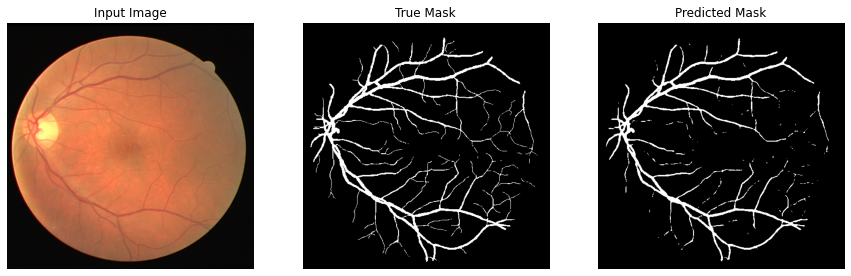


Sample Prediction after epoch 271

Epoch 272/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0560 - accuracy: 0.9867 - dice_coef: 0.7652 - iou: 0.6198 - recall: 0.9139 - precision: 0.9307
Epoch 273/400
3/3 [==============================] - 1s 327ms/step - loss: 0.0551 - accuracy: 0.9873 - dice_coef: 0.7676 - iou: 0.6229 - recall: 0.9172 - precision: 0.9341
Epoch 274/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0554 - accuracy: 0.9871 - dice_coef: 0.7674 - iou: 0.6226 - recall: 0.9147 - precision: 0.9335
Epoch 275/400
3/3 [==============================] - 1s 331ms/step - loss: 0.0544 - accuracy: 0.9876 - dice_coef: 0.7691 - iou: 0.6249 - recall: 0.9185 - precision: 0.9365
Epoch 276/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0543 - accuracy: 0.9875 - dice_coef: 0.7703 - iou: 0.6265 - recall: 0.9194 - precision: 0.9342


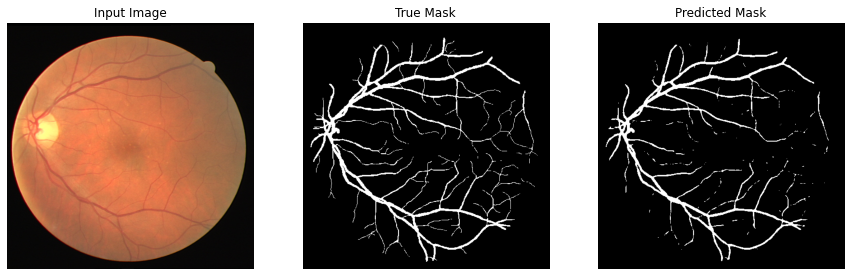


Sample Prediction after epoch 276

Epoch 277/400
3/3 [==============================] - 1s 331ms/step - loss: 0.0543 - accuracy: 0.9874 - dice_coef: 0.7703 - iou: 0.6264 - recall: 0.9174 - precision: 0.9354
Epoch 278/400
3/3 [==============================] - 1s 320ms/step - loss: 0.0543 - accuracy: 0.9873 - dice_coef: 0.7709 - iou: 0.6272 - recall: 0.9170 - precision: 0.9342
Epoch 279/400
3/3 [==============================] - 1s 322ms/step - loss: 0.0537 - accuracy: 0.9877 - dice_coef: 0.7726 - iou: 0.6295 - recall: 0.9199 - precision: 0.9358
Epoch 280/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0533 - accuracy: 0.9879 - dice_coef: 0.7735 - iou: 0.6307 - recall: 0.9208 - precision: 0.9373
Epoch 281/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0541 - accuracy: 0.9872 - dice_coef: 0.7728 - iou: 0.6298 - recall: 0.9157 - precision: 0.9343


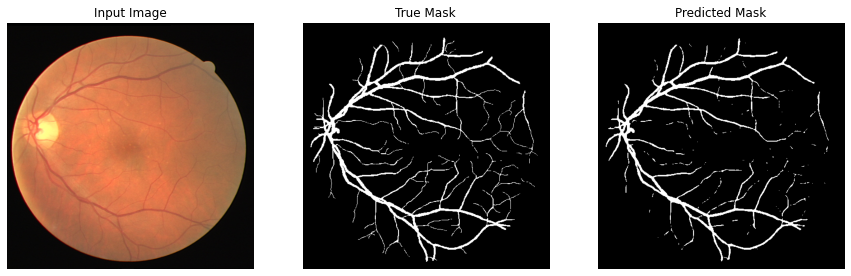


Sample Prediction after epoch 281

Epoch 282/400
3/3 [==============================] - 1s 331ms/step - loss: 0.0543 - accuracy: 0.9869 - dice_coef: 0.7731 - iou: 0.6301 - recall: 0.9135 - precision: 0.9330
Epoch 283/400
3/3 [==============================] - 1s 331ms/step - loss: 0.0534 - accuracy: 0.9875 - dice_coef: 0.7753 - iou: 0.6330 - recall: 0.9208 - precision: 0.9333
Epoch 284/400
3/3 [==============================] - 1s 376ms/step - loss: 0.0538 - accuracy: 0.9871 - dice_coef: 0.7744 - iou: 0.6318 - recall: 0.9145 - precision: 0.9339
Epoch 285/400
3/3 [==============================] - 1s 332ms/step - loss: 0.0533 - accuracy: 0.9872 - dice_coef: 0.7754 - iou: 0.6332 - recall: 0.9166 - precision: 0.9339
Epoch 286/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0522 - accuracy: 0.9879 - dice_coef: 0.7783 - iou: 0.6371 - recall: 0.9224 - precision: 0.9362


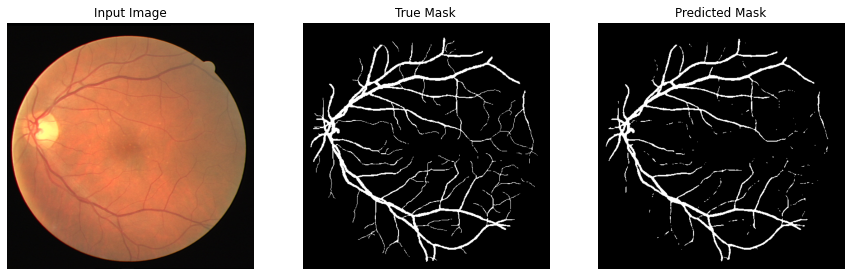


Sample Prediction after epoch 286

Epoch 287/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0523 - accuracy: 0.9877 - dice_coef: 0.7783 - iou: 0.6371 - recall: 0.9199 - precision: 0.9365
Epoch 288/400
3/3 [==============================] - 1s 345ms/step - loss: 0.0529 - accuracy: 0.9872 - dice_coef: 0.7774 - iou: 0.6359 - recall: 0.9140 - precision: 0.9356
Epoch 289/400
3/3 [==============================] - 1s 325ms/step - loss: 0.0518 - accuracy: 0.9878 - dice_coef: 0.7802 - iou: 0.6396 - recall: 0.9233 - precision: 0.9344
Epoch 290/400
3/3 [==============================] - 1s 353ms/step - loss: 0.0517 - accuracy: 0.9878 - dice_coef: 0.7806 - iou: 0.6402 - recall: 0.9182 - precision: 0.9391
Epoch 291/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0512 - accuracy: 0.9881 - dice_coef: 0.7819 - iou: 0.6419 - recall: 0.9245 - precision: 0.9365


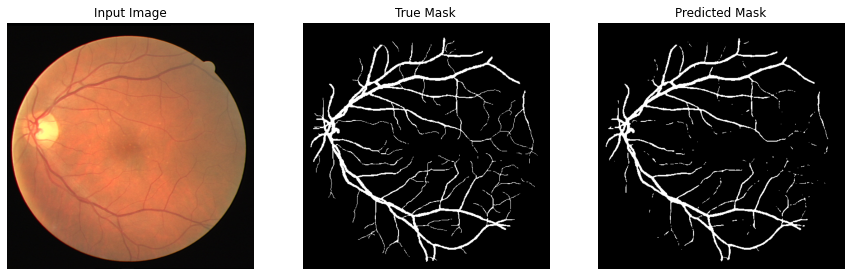


Sample Prediction after epoch 291

Epoch 292/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0519 - accuracy: 0.9874 - dice_coef: 0.7808 - iou: 0.6404 - recall: 0.9173 - precision: 0.9356
Epoch 293/400
3/3 [==============================] - 1s 324ms/step - loss: 0.0518 - accuracy: 0.9876 - dice_coef: 0.7817 - iou: 0.6417 - recall: 0.9194 - precision: 0.9349
Epoch 294/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0511 - accuracy: 0.9878 - dice_coef: 0.7830 - iou: 0.6434 - recall: 0.9204 - precision: 0.9371
Epoch 295/400
3/3 [==============================] - 1s 327ms/step - loss: 0.0510 - accuracy: 0.9878 - dice_coef: 0.7837 - iou: 0.6443 - recall: 0.9201 - precision: 0.9364
Epoch 296/400
3/3 [==============================] - 1s 338ms/step - loss: 0.0503 - accuracy: 0.9882 - dice_coef: 0.7858 - iou: 0.6472 - recall: 0.9243 - precision: 0.9378


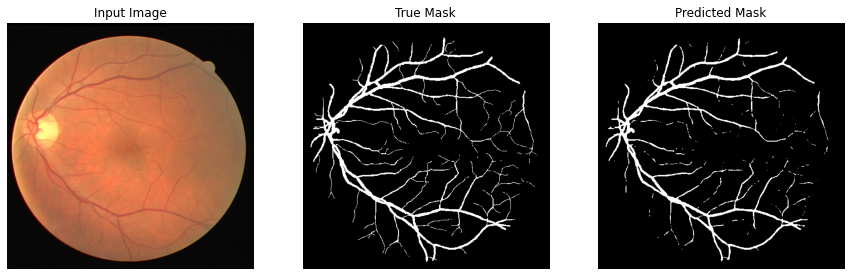


Sample Prediction after epoch 296

Epoch 297/400
3/3 [==============================] - 1s 321ms/step - loss: 0.0502 - accuracy: 0.9881 - dice_coef: 0.7855 - iou: 0.6468 - recall: 0.9228 - precision: 0.9383
Epoch 298/400
3/3 [==============================] - 1s 333ms/step - loss: 0.0495 - accuracy: 0.9885 - dice_coef: 0.7874 - iou: 0.6494 - recall: 0.9259 - precision: 0.9401
Epoch 299/400
3/3 [==============================] - 1s 332ms/step - loss: 0.0509 - accuracy: 0.9875 - dice_coef: 0.7838 - iou: 0.6445 - recall: 0.9174 - precision: 0.9366
Epoch 300/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0501 - accuracy: 0.9880 - dice_coef: 0.7874 - iou: 0.6494 - recall: 0.9247 - precision: 0.9349
Epoch 301/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0495 - accuracy: 0.9882 - dice_coef: 0.7883 - iou: 0.6506 - recall: 0.9219 - precision: 0.9404


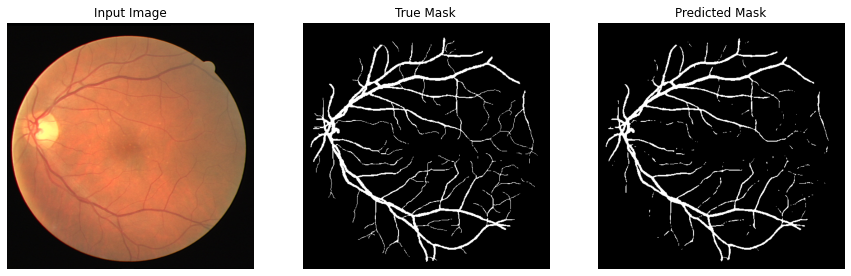


Sample Prediction after epoch 301

Epoch 302/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0510 - accuracy: 0.9873 - dice_coef: 0.7849 - iou: 0.6459 - recall: 0.9152 - precision: 0.9355
Epoch 303/400
3/3 [==============================] - 1s 331ms/step - loss: 0.0496 - accuracy: 0.9880 - dice_coef: 0.7898 - iou: 0.6526 - recall: 0.9244 - precision: 0.9357
Epoch 304/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0495 - accuracy: 0.9880 - dice_coef: 0.7899 - iou: 0.6528 - recall: 0.9235 - precision: 0.9366
Epoch 305/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0491 - accuracy: 0.9882 - dice_coef: 0.7908 - iou: 0.6540 - recall: 0.9227 - precision: 0.9396
Epoch 306/400
3/3 [==============================] - 1s 358ms/step - loss: 0.0489 - accuracy: 0.9882 - dice_coef: 0.7922 - iou: 0.6559 - recall: 0.9245 - precision: 0.9375


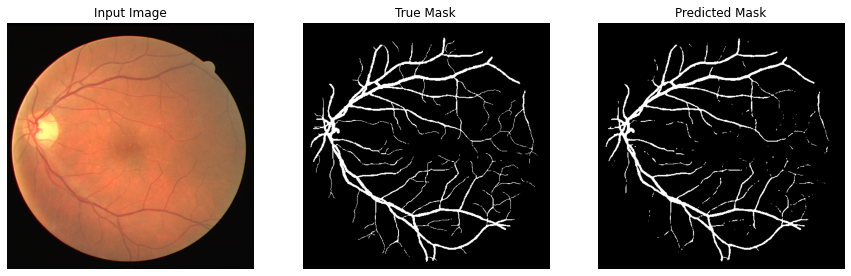


Sample Prediction after epoch 306

Epoch 307/400
3/3 [==============================] - 1s 332ms/step - loss: 0.0483 - accuracy: 0.9887 - dice_coef: 0.7934 - iou: 0.6576 - recall: 0.9273 - precision: 0.9406
Epoch 308/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0488 - accuracy: 0.9882 - dice_coef: 0.7928 - iou: 0.6568 - recall: 0.9211 - precision: 0.9401
Epoch 309/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0488 - accuracy: 0.9881 - dice_coef: 0.7929 - iou: 0.6569 - recall: 0.9235 - precision: 0.9370
Epoch 310/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0475 - accuracy: 0.9890 - dice_coef: 0.7958 - iou: 0.6610 - recall: 0.9288 - precision: 0.9427
Epoch 311/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0484 - accuracy: 0.9881 - dice_coef: 0.7945 - iou: 0.6591 - recall: 0.9226 - precision: 0.9380


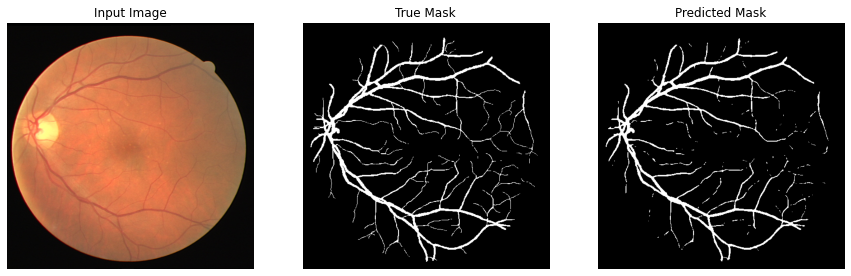


Sample Prediction after epoch 311

Epoch 312/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0479 - accuracy: 0.9884 - dice_coef: 0.7955 - iou: 0.6605 - recall: 0.9243 - precision: 0.9395
Epoch 313/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0471 - accuracy: 0.9889 - dice_coef: 0.7971 - iou: 0.6627 - recall: 0.9282 - precision: 0.9424
Epoch 314/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0475 - accuracy: 0.9885 - dice_coef: 0.7975 - iou: 0.6633 - recall: 0.9259 - precision: 0.9396
Epoch 315/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0469 - accuracy: 0.9889 - dice_coef: 0.7990 - iou: 0.6653 - recall: 0.9296 - precision: 0.9406
Epoch 316/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0466 - accuracy: 0.9889 - dice_coef: 0.7981 - iou: 0.6641 - recall: 0.9269 - precision: 0.9433


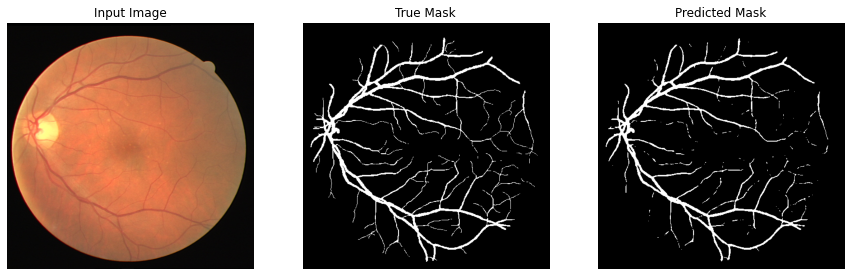


Sample Prediction after epoch 316

Epoch 317/400
3/3 [==============================] - 1s 332ms/step - loss: 0.0467 - accuracy: 0.9888 - dice_coef: 0.7996 - iou: 0.6662 - recall: 0.9294 - precision: 0.9401
Epoch 318/400
3/3 [==============================] - 1s 343ms/step - loss: 0.0463 - accuracy: 0.9890 - dice_coef: 0.8012 - iou: 0.6683 - recall: 0.9295 - precision: 0.9421
Epoch 319/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0469 - accuracy: 0.9885 - dice_coef: 0.7988 - iou: 0.6650 - recall: 0.9254 - precision: 0.9399
Epoch 320/400
3/3 [==============================] - 1s 365ms/step - loss: 0.0462 - accuracy: 0.9890 - dice_coef: 0.8016 - iou: 0.6689 - recall: 0.9291 - precision: 0.9420
Epoch 321/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0456 - accuracy: 0.9893 - dice_coef: 0.8031 - iou: 0.6711 - recall: 0.9317 - precision: 0.9437


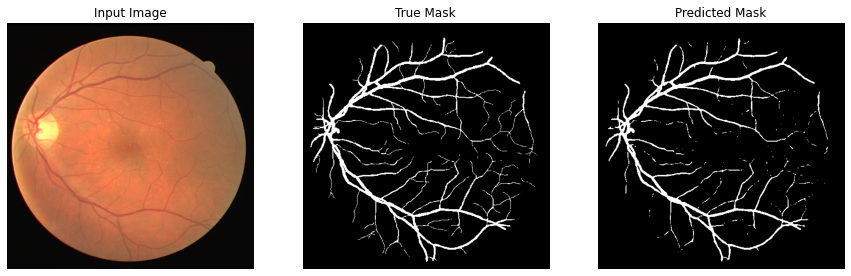


Sample Prediction after epoch 321

Epoch 322/400
3/3 [==============================] - 1s 336ms/step - loss: 0.0467 - accuracy: 0.9884 - dice_coef: 0.8010 - iou: 0.6681 - recall: 0.9234 - precision: 0.9406
Epoch 323/400
3/3 [==============================] - 1s 338ms/step - loss: 0.0454 - accuracy: 0.9893 - dice_coef: 0.8043 - iou: 0.6728 - recall: 0.9332 - precision: 0.9423
Epoch 324/400
3/3 [==============================] - 1s 327ms/step - loss: 0.0468 - accuracy: 0.9881 - dice_coef: 0.8018 - iou: 0.6692 - recall: 0.9213 - precision: 0.9390
Epoch 325/400
3/3 [==============================] - 1s 323ms/step - loss: 0.0451 - accuracy: 0.9893 - dice_coef: 0.8056 - iou: 0.6746 - recall: 0.9330 - precision: 0.9419
Epoch 326/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0453 - accuracy: 0.9890 - dice_coef: 0.8042 - iou: 0.6725 - recall: 0.9293 - precision: 0.9423


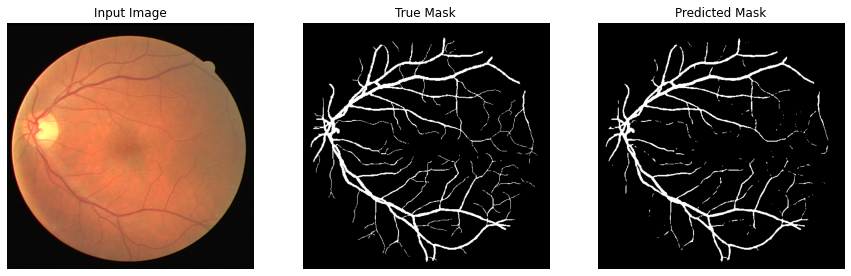


Sample Prediction after epoch 326

Epoch 327/400
3/3 [==============================] - 1s 332ms/step - loss: 0.0449 - accuracy: 0.9893 - dice_coef: 0.8064 - iou: 0.6757 - recall: 0.9313 - precision: 0.9438
Epoch 328/400
3/3 [==============================] - 1s 365ms/step - loss: 0.0441 - accuracy: 0.9898 - dice_coef: 0.8083 - iou: 0.6784 - recall: 0.9351 - precision: 0.9453
Epoch 329/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0446 - accuracy: 0.9893 - dice_coef: 0.8072 - iou: 0.6767 - recall: 0.9303 - precision: 0.9444
Epoch 330/400
3/3 [==============================] - 1s 323ms/step - loss: 0.0435 - accuracy: 0.9902 - dice_coef: 0.8102 - iou: 0.6810 - recall: 0.9384 - precision: 0.9469
Epoch 331/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0438 - accuracy: 0.9898 - dice_coef: 0.8098 - iou: 0.6804 - recall: 0.9327 - precision: 0.9477


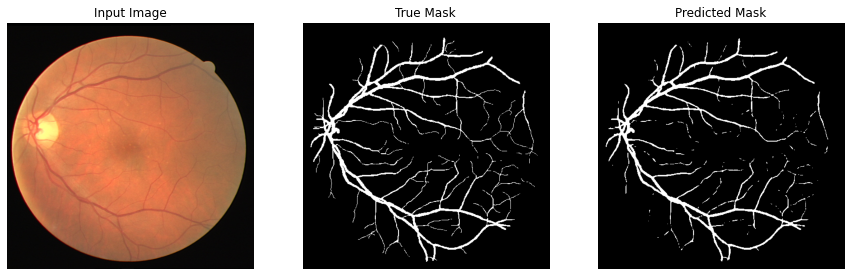


Sample Prediction after epoch 331

Epoch 332/400
3/3 [==============================] - 1s 326ms/step - loss: 0.0442 - accuracy: 0.9895 - dice_coef: 0.8096 - iou: 0.6802 - recall: 0.9334 - precision: 0.9435
Epoch 333/400
3/3 [==============================] - 1s 335ms/step - loss: 0.0436 - accuracy: 0.9898 - dice_coef: 0.8112 - iou: 0.6824 - recall: 0.9342 - precision: 0.9462
Epoch 334/400
3/3 [==============================] - 2s 368ms/step - loss: 0.0433 - accuracy: 0.9899 - dice_coef: 0.8119 - iou: 0.6834 - recall: 0.9368 - precision: 0.9457
Epoch 335/400
3/3 [==============================] - 1s 324ms/step - loss: 0.0431 - accuracy: 0.9900 - dice_coef: 0.8124 - iou: 0.6842 - recall: 0.9349 - precision: 0.9486
Epoch 336/400
3/3 [==============================] - 1s 327ms/step - loss: 0.0433 - accuracy: 0.9898 - dice_coef: 0.8131 - iou: 0.6851 - recall: 0.9371 - precision: 0.9441


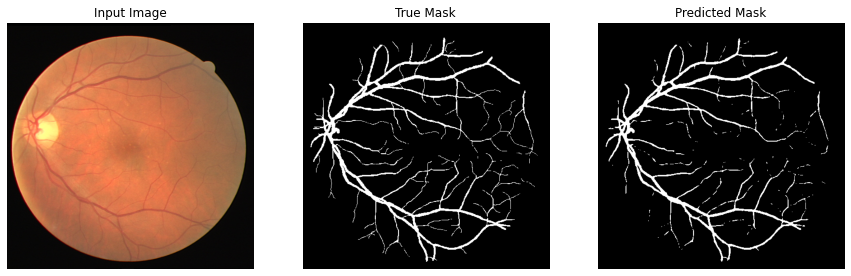


Sample Prediction after epoch 336

Epoch 337/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0433 - accuracy: 0.9898 - dice_coef: 0.8131 - iou: 0.6851 - recall: 0.9330 - precision: 0.9472
Epoch 338/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0436 - accuracy: 0.9894 - dice_coef: 0.8114 - iou: 0.6827 - recall: 0.9310 - precision: 0.9455
Epoch 339/400
3/3 [==============================] - 1s 363ms/step - loss: 0.0431 - accuracy: 0.9896 - dice_coef: 0.8142 - iou: 0.6867 - recall: 0.9352 - precision: 0.9435
Epoch 340/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0439 - accuracy: 0.9891 - dice_coef: 0.8131 - iou: 0.6851 - recall: 0.9296 - precision: 0.9430
Epoch 341/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0423 - accuracy: 0.9900 - dice_coef: 0.8158 - iou: 0.6890 - recall: 0.9376 - precision: 0.9460


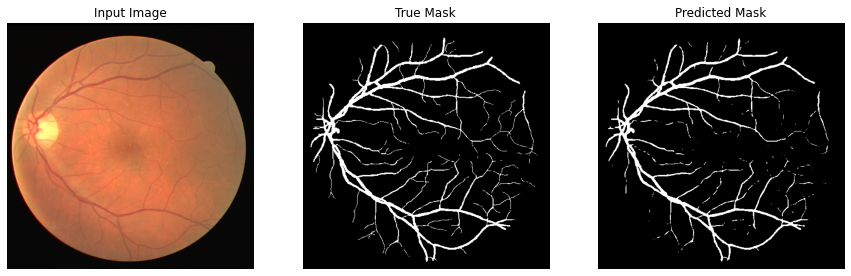


Sample Prediction after epoch 341

Epoch 342/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0421 - accuracy: 0.9901 - dice_coef: 0.8166 - iou: 0.6901 - recall: 0.9361 - precision: 0.9486
Epoch 343/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0428 - accuracy: 0.9898 - dice_coef: 0.8163 - iou: 0.6897 - recall: 0.9342 - precision: 0.9461
Epoch 344/400
3/3 [==============================] - 1s 323ms/step - loss: 0.0420 - accuracy: 0.9901 - dice_coef: 0.8173 - iou: 0.6911 - recall: 0.9363 - precision: 0.9475
Epoch 345/400
3/3 [==============================] - 1s 337ms/step - loss: 0.0416 - accuracy: 0.9903 - dice_coef: 0.8187 - iou: 0.6931 - recall: 0.9403 - precision: 0.9463
Epoch 346/400
3/3 [==============================] - 1s 321ms/step - loss: 0.0418 - accuracy: 0.9900 - dice_coef: 0.8179 - iou: 0.6920 - recall: 0.9345 - precision: 0.9485


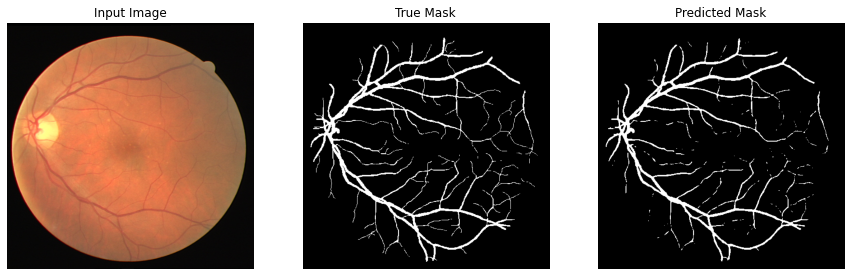


Sample Prediction after epoch 346

Epoch 347/400
3/3 [==============================] - 1s 341ms/step - loss: 0.0409 - accuracy: 0.9907 - dice_coef: 0.8206 - iou: 0.6959 - recall: 0.9427 - precision: 0.9490
Epoch 348/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0427 - accuracy: 0.9893 - dice_coef: 0.8176 - iou: 0.6916 - recall: 0.9297 - precision: 0.9451
Epoch 349/400
3/3 [==============================] - 1s 334ms/step - loss: 0.0410 - accuracy: 0.9905 - dice_coef: 0.8210 - iou: 0.6964 - recall: 0.9411 - precision: 0.9478
Epoch 350/400
3/3 [==============================] - 1s 341ms/step - loss: 0.0418 - accuracy: 0.9899 - dice_coef: 0.8200 - iou: 0.6950 - recall: 0.9336 - precision: 0.9480
Epoch 351/400
3/3 [==============================] - 1s 358ms/step - loss: 0.0414 - accuracy: 0.9902 - dice_coef: 0.8207 - iou: 0.6960 - recall: 0.9384 - precision: 0.9470


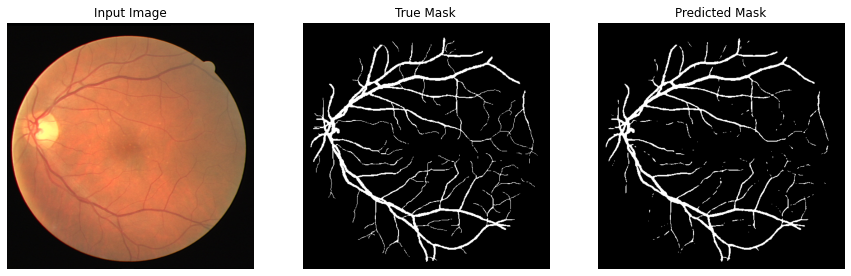


Sample Prediction after epoch 351

Epoch 352/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0407 - accuracy: 0.9905 - dice_coef: 0.8224 - iou: 0.6984 - recall: 0.9390 - precision: 0.9499
Epoch 353/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0410 - accuracy: 0.9902 - dice_coef: 0.8222 - iou: 0.6982 - recall: 0.9366 - precision: 0.9493
Epoch 354/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0407 - accuracy: 0.9902 - dice_coef: 0.8226 - iou: 0.6987 - recall: 0.9407 - precision: 0.9455
Epoch 355/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0401 - accuracy: 0.9907 - dice_coef: 0.8244 - iou: 0.7013 - recall: 0.9414 - precision: 0.9495
Epoch 356/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0397 - accuracy: 0.9909 - dice_coef: 0.8252 - iou: 0.7025 - recall: 0.9404 - precision: 0.9528


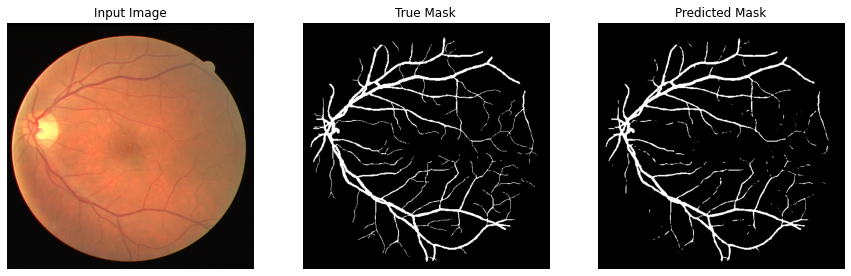


Sample Prediction after epoch 356

Epoch 357/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0398 - accuracy: 0.9908 - dice_coef: 0.8261 - iou: 0.7037 - recall: 0.9430 - precision: 0.9495
Epoch 358/400
3/3 [==============================] - 1s 327ms/step - loss: 0.0406 - accuracy: 0.9901 - dice_coef: 0.8232 - iou: 0.6995 - recall: 0.9349 - precision: 0.9490
Epoch 359/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0393 - accuracy: 0.9909 - dice_coef: 0.8272 - iou: 0.7054 - recall: 0.9441 - precision: 0.9500
Epoch 360/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0392 - accuracy: 0.9910 - dice_coef: 0.8276 - iou: 0.7060 - recall: 0.9423 - precision: 0.9521
Epoch 361/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0386 - accuracy: 0.9914 - dice_coef: 0.8288 - iou: 0.7077 - recall: 0.9459 - precision: 0.9538


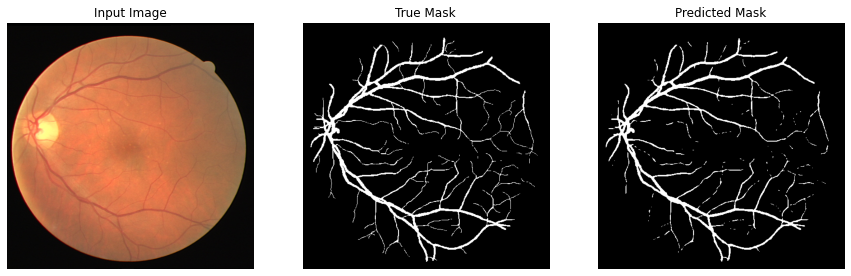


Sample Prediction after epoch 361

Epoch 362/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0389 - accuracy: 0.9911 - dice_coef: 0.8290 - iou: 0.7080 - recall: 0.9429 - precision: 0.9532
Epoch 363/400
3/3 [==============================] - 1s 327ms/step - loss: 0.0419 - accuracy: 0.9891 - dice_coef: 0.8215 - iou: 0.6970 - recall: 0.9277 - precision: 0.9441
Epoch 364/400
3/3 [==============================] - 1s 326ms/step - loss: 0.0392 - accuracy: 0.9907 - dice_coef: 0.8292 - iou: 0.7083 - recall: 0.9450 - precision: 0.9469
Epoch 365/400
3/3 [==============================] - 1s 326ms/step - loss: 0.0386 - accuracy: 0.9911 - dice_coef: 0.8303 - iou: 0.7098 - recall: 0.9424 - precision: 0.9540
Epoch 366/400
3/3 [==============================] - 1s 331ms/step - loss: 0.0389 - accuracy: 0.9908 - dice_coef: 0.8302 - iou: 0.7098 - recall: 0.9407 - precision: 0.9521


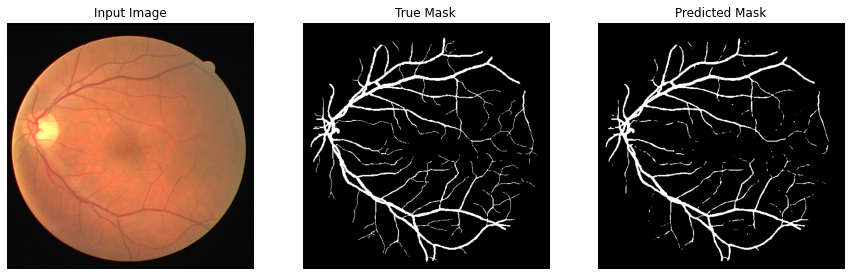


Sample Prediction after epoch 366

Epoch 367/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0386 - accuracy: 0.9910 - dice_coef: 0.8313 - iou: 0.7114 - recall: 0.9446 - precision: 0.9506
Epoch 368/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0393 - accuracy: 0.9905 - dice_coef: 0.8282 - iou: 0.7068 - recall: 0.9376 - precision: 0.9508
Epoch 369/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0391 - accuracy: 0.9905 - dice_coef: 0.8298 - iou: 0.7092 - recall: 0.9405 - precision: 0.9488
Epoch 370/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0378 - accuracy: 0.9913 - dice_coef: 0.8333 - iou: 0.7144 - recall: 0.9471 - precision: 0.9515
Epoch 371/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0383 - accuracy: 0.9909 - dice_coef: 0.8324 - iou: 0.7130 - recall: 0.9412 - precision: 0.9526


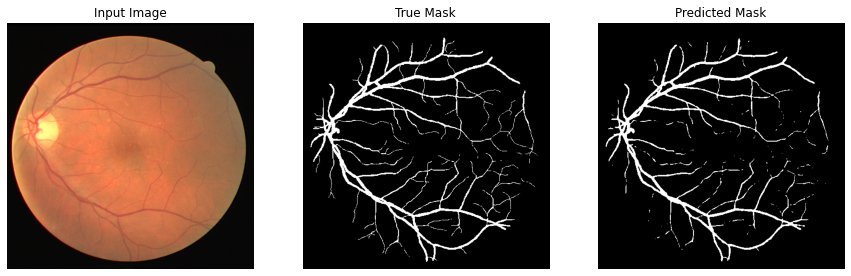


Sample Prediction after epoch 371

Epoch 372/400
3/3 [==============================] - 1s 322ms/step - loss: 0.0372 - accuracy: 0.9917 - dice_coef: 0.8348 - iou: 0.7166 - recall: 0.9477 - precision: 0.9557
Epoch 373/400
3/3 [==============================] - 1s 327ms/step - loss: 0.0373 - accuracy: 0.9915 - dice_coef: 0.8351 - iou: 0.7170 - recall: 0.9469 - precision: 0.9545
Epoch 374/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0372 - accuracy: 0.9915 - dice_coef: 0.8356 - iou: 0.7176 - recall: 0.9462 - precision: 0.9551
Epoch 375/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0386 - accuracy: 0.9905 - dice_coef: 0.8312 - iou: 0.7112 - recall: 0.9384 - precision: 0.9502
Epoch 376/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0370 - accuracy: 0.9916 - dice_coef: 0.8367 - iou: 0.7193 - recall: 0.9498 - precision: 0.9522


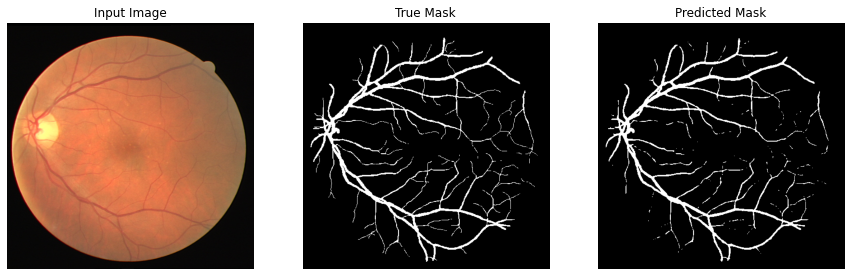


Sample Prediction after epoch 376

Epoch 377/400
3/3 [==============================] - 1s 327ms/step - loss: 0.0375 - accuracy: 0.9911 - dice_coef: 0.8333 - iou: 0.7142 - recall: 0.9424 - precision: 0.9541
Epoch 378/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0370 - accuracy: 0.9914 - dice_coef: 0.8370 - iou: 0.7197 - recall: 0.9469 - precision: 0.9532
Epoch 379/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0372 - accuracy: 0.9913 - dice_coef: 0.8367 - iou: 0.7194 - recall: 0.9448 - precision: 0.9532
Epoch 380/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0379 - accuracy: 0.9908 - dice_coef: 0.8351 - iou: 0.7169 - recall: 0.9406 - precision: 0.9523
Epoch 381/400
3/3 [==============================] - 1s 327ms/step - loss: 0.0364 - accuracy: 0.9917 - dice_coef: 0.8388 - iou: 0.7224 - recall: 0.9479 - precision: 0.9548


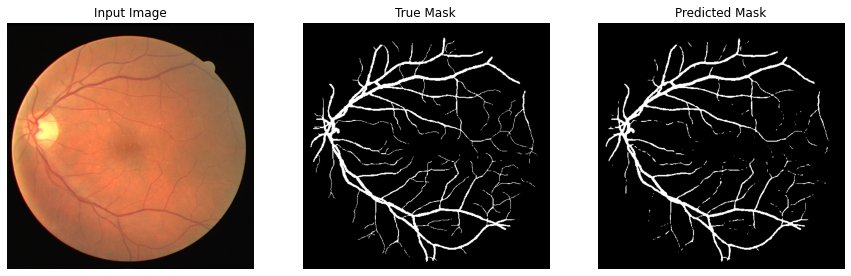


Sample Prediction after epoch 381

Epoch 382/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0370 - accuracy: 0.9911 - dice_coef: 0.8370 - iou: 0.7198 - recall: 0.9452 - precision: 0.9515
Epoch 383/400
3/3 [==============================] - 1s 347ms/step - loss: 0.0362 - accuracy: 0.9917 - dice_coef: 0.8397 - iou: 0.7237 - recall: 0.9474 - precision: 0.9563
Epoch 384/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0364 - accuracy: 0.9915 - dice_coef: 0.8397 - iou: 0.7238 - recall: 0.9467 - precision: 0.9547
Epoch 385/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0372 - accuracy: 0.9910 - dice_coef: 0.8384 - iou: 0.7219 - recall: 0.9425 - precision: 0.9523
Epoch 386/400
3/3 [==============================] - 1s 331ms/step - loss: 0.0362 - accuracy: 0.9915 - dice_coef: 0.8401 - iou: 0.7244 - recall: 0.9471 - precision: 0.9536


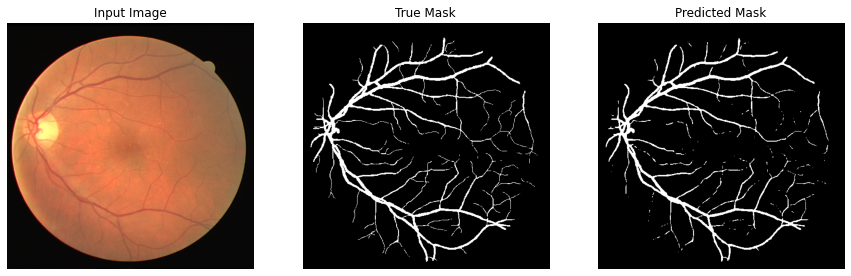


Sample Prediction after epoch 386

Epoch 387/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0358 - accuracy: 0.9919 - dice_coef: 0.8417 - iou: 0.7267 - recall: 0.9491 - precision: 0.9559
Epoch 388/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0358 - accuracy: 0.9918 - dice_coef: 0.8423 - iou: 0.7276 - recall: 0.9486 - precision: 0.9563
Epoch 389/400
3/3 [==============================] - 1s 338ms/step - loss: 0.0348 - accuracy: 0.9925 - dice_coef: 0.8442 - iou: 0.7305 - recall: 0.9532 - precision: 0.9589
Epoch 390/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0354 - accuracy: 0.9919 - dice_coef: 0.8431 - iou: 0.7288 - recall: 0.9495 - precision: 0.9559
Epoch 391/400
3/3 [==============================] - 1s 330ms/step - loss: 0.0349 - accuracy: 0.9922 - dice_coef: 0.8430 - iou: 0.7287 - recall: 0.9504 - precision: 0.9585


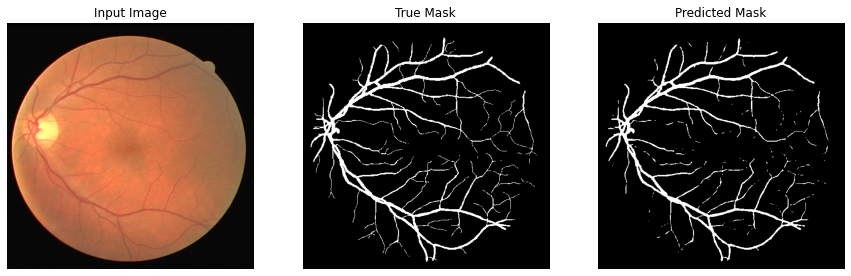


Sample Prediction after epoch 391

Epoch 392/400
3/3 [==============================] - 1s 325ms/step - loss: 0.0346 - accuracy: 0.9924 - dice_coef: 0.8450 - iou: 0.7316 - recall: 0.9535 - precision: 0.9574
Epoch 393/400
3/3 [==============================] - 1s 326ms/step - loss: 0.0344 - accuracy: 0.9924 - dice_coef: 0.8455 - iou: 0.7324 - recall: 0.9533 - precision: 0.9587
Epoch 394/400
3/3 [==============================] - 1s 357ms/step - loss: 0.0349 - accuracy: 0.9920 - dice_coef: 0.8451 - iou: 0.7319 - recall: 0.9496 - precision: 0.9574
Epoch 395/400
3/3 [==============================] - 1s 328ms/step - loss: 0.0343 - accuracy: 0.9924 - dice_coef: 0.8466 - iou: 0.7341 - recall: 0.9522 - precision: 0.9590
Epoch 396/400
3/3 [==============================] - 1s 327ms/step - loss: 0.0342 - accuracy: 0.9925 - dice_coef: 0.8471 - iou: 0.7349 - recall: 0.9545 - precision: 0.9578


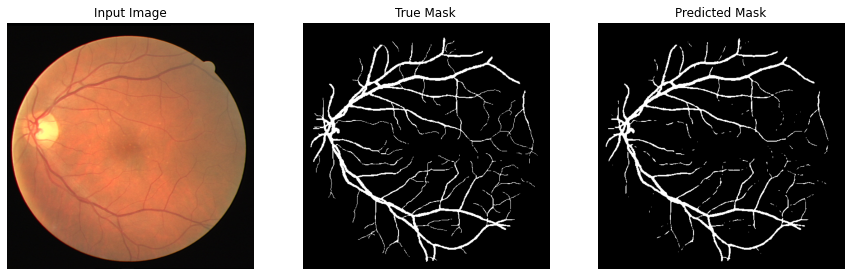


Sample Prediction after epoch 396

Epoch 397/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0347 - accuracy: 0.9921 - dice_coef: 0.8457 - iou: 0.7328 - recall: 0.9478 - precision: 0.9595
Epoch 398/400
3/3 [==============================] - 1s 329ms/step - loss: 0.0348 - accuracy: 0.9919 - dice_coef: 0.8458 - iou: 0.7329 - recall: 0.9516 - precision: 0.9546
Epoch 399/400
3/3 [==============================] - 1s 327ms/step - loss: 0.0344 - accuracy: 0.9920 - dice_coef: 0.8469 - iou: 0.7344 - recall: 0.9511 - precision: 0.9557
Epoch 400/400
3/3 [==============================] - 1s 333ms/step - loss: 0.0351 - accuracy: 0.9915 - dice_coef: 0.8456 - iou: 0.7326 - recall: 0.9448 - precision: 0.9556


In [168]:
model.fit(
    train_dataset,
    callbacks=[DisplayCallback(train_dataset)],
    epochs=400)


In [169]:
!nvidia-smi

Wed Sep 21 14:55:29 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.82.01    Driver Version: 470.82.01    CUDA Version: 11.4     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   68C    P0    47W / 250W |  15977MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [170]:
def create_mask(pred_mask):
    pred_mask = (pred_mask > 0.5).astype("int32")
    return pred_mask[0]

In [171]:
import cv2

In [172]:
from PIL import Image
img = Image.open('../input/testretina/test.jpg')
img.save('image.tiff')

In [173]:
x=read_files("./image.tiff")

In [174]:
x.shape

TensorShape([512, 512, 3])

In [175]:
from tensorflow.python.ops.numpy_ops import np_config
np_config.enable_numpy_behavior()

In [176]:
x=x.reshape([1,512,512,3])  

In [177]:
x.shape

TensorShape([1, 512, 512, 3])

In [178]:
pred=model.predict(x)

In [179]:
pred_masked=create_mask(pred)

In [180]:
pred_masked.shape

(512, 512, 1)

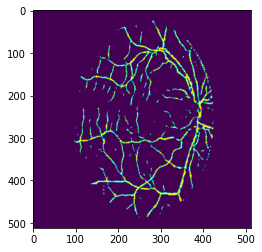

In [181]:
plt.imshow(pred_masked)

In [182]:
model.save("unetsm")

/opt/conda/lib/python3.7/site-packages/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


In [154]:
from keras.models import load_model
new_model = load_model("./unetscratch",custom_objects={'dice_coef':dice_coef,'iou':iou})

In [155]:
print(new_model)

In [156]:
pred=new_model.predict(x)

In [157]:
pred_masked=create_mask(pred)

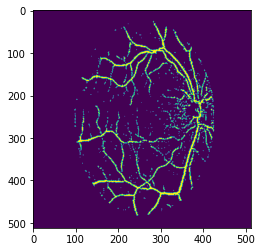

In [158]:
plt.imshow(pred_masked)

In [159]:
#new_model

input_data = "./HIGHRES/"
images = sorted(
    [
        os.path.join(input_data, fname)
        for fname in os.listdir(input_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

In [160]:
target_data = "./DRIVE/training/1st_manual"
masks = sorted(
    [
        os.path.join(target_data, fname)
        for fname in os.listdir(target_data)
        if fname.endswith(exts) and not fname.startswith(".")
    ]
)

In [161]:
print("Number of samples:", len(images), len(masks))
for input_path, target_path in zip(images[:10], masks[:10]):
    print(input_path[-31:], "|", target_path[-34:])

Number of samples: 0 20


In [162]:
train_dataset = data_generator(images, masks)
train_dataset

ValueError: Dimensions 0 and 20 are not compatible

In [ ]:
image, mask = next(iter(train_dataset.take(1))) 
print(image.shape, mask.shape)

for (img, msk) in zip(image[:10], mask[:10]):
    print(mask.numpy().min(), mask.numpy().max())
    print(np.unique(mask.numpy()))
    visualize(
        image=img.numpy(),
        gt_mask=msk.numpy(),
    )

In [ ]:
from tensorflow import keras 
keras.backend.clear_session()
BACKBONE   = 'efficientnetb0'
n_classes  = 1 
activation = 'sigmoid' 
model = sm.Unet(BACKBONE, classes=n_classes, activation=activation)
model.summary(line_length=110)

In [ ]:
optim = keras.optimizers.Adam(0.0001)
bce   = keras.losses.BinaryCrossentropy()
metrics = ["accuracy"]

# compile keras model with defined optimozer, loss and metrics
model.compile(optim, bce, metrics)

In [ ]:
model.fit(
    train_dataset, 
    callbacks=[DisplayCallback(train_dataset)],
    epochs=400
)

In [ ]:
model.save("unet2")

In [183]:
!zip -r "unet2.zip" "./unetsm"

  adding: unetsm/ (stored 0%)
  adding: unetsm/saved_model.pb (deflated 91%)
  adding: unetsm/variables/ (stored 0%)
  adding: unetsm/variables/variables.data-00000-of-00001 (deflated 8%)
  adding: unetsm/variables/variables.index (deflated 79%)
  adding: unetsm/keras_metadata.pb (deflated 96%)
  adding: unetsm/assets/ (stored 0%)


In [184]:
from IPython.display import FileLink
FileLink(r'unet2.zip')

/kaggle/working/unet2.zip